In [1]:
import pycpt
import packaging
min_version = '2.6.1'
assert packaging.version.parse(pycpt.__version__) >= packaging.version.parse(min_version), f'This notebook requires version {min_version} or higher of the pycpt library, but you have version {pycpt.__version__}. Please close the notebook, update your environment, and load the notebook again. See https://iri-pycpt.github.io/installation/'

import cptdl as dl 
from cptextras import get_colors_bars
import datetime as dt
import numpy as np
from pathlib import Path
import xarray as xr
import cptcore as cc
import scipy.ndimage as ndimage
import matplotlib.pyplot as plt
import pandas as pd
from dateutil.relativedelta import relativedelta
import cartopy.crs as ccrs
from sklearn.cross_decomposition import CCA, PLSCanonical, PLSSVD, PLSRegression
from sklearn.decomposition import PCA
from xmca.xarray import xMCA
from xmca.array import MCA

# Load data

In [3]:
era5 = xr.open_dataset('data/era5.nc', decode_times=False)
#time is YYYMMDD change ot datetime
# Convert to pandas datetime using the correct format
date_times = pd.to_datetime(era5.date.values.astype(str), format='%Y%m%d')
# Assign the datetime values back to the DataArray if needed
era5 = era5.swap_dims({'date':'time', 'longitude':'lon', 'latitude':'lat'})
era5 = era5.assign_coords(time=date_times, lon = era5.longitude, lat = era5.latitude)

era5 = era5.drop(['date','latitude', 'longitude', 'expver','number'])

era5['tp'] = era5['tp']*1000*30
era5 = era5.sortby('time')

era5['tp3m'] = era5['tp'] + era5['tp'].shift(time=1) + era5['tp'].shift(time=2)
era5 = era5.sel(lat=slice(37, 12), lon=slice(32,60))

array_list = []
for month in range(1, 13):
    reference_period = era5['tp3m'].sel(time=era5['time.month']==month).sel(time=slice('1991-01-01', '2020-12-01'))
    data_month = era5['tp3m'].sel(time=era5['time.month']==month)
    data_month = (data_month - reference_period.mean(dim='time') )  / (reference_period.std(dim='time') + 1e-10)
    array_list.append(data_month)
era5_anomalies = xr.concat(array_list, dim='time')

era5['anomaly_3m'] = era5_anomalies

#NOAA COBE SST data
sst = xr.open_dataset('data/sst.mon.mean.nc').sortby('time')
sst['sst3m'] = sst['sst'] + sst['sst'].shift(time=1) + sst['sst'].shift(time=2)

#put lon is -180 to 180
sst = sst.assign_coords(lon=(((sst.lon + 180) % 360) - 180)).sortby('lon')



C:\Users\emile\AppData\Local\Temp\ipykernel_2684\1278871163.py:9: DeprecationWarning: dropping variables using `drop` is deprecated; use drop_vars.
  era5 = era5.drop(['date','latitude', 'longitude', 'expver','number'])


In [4]:
#match time periods
sst = sst.sel(time=slice(era5.time[0], era5.time[-1]), lat=slice(60, -60), lon=slice(-180, 180))
#match give same time period
era5 = era5.sel(time=slice(sst.time[0], sst.time[-1]))
sst = sst.sel(time=slice(era5.time[0], era5.time[-1]))

# Total Period

## SVD

In [5]:
def svd_analysis(precip, sst, n_modes=3, month=None):
    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        month_num = months.index(month) + 1
        sst = sst.sel(time=sst['time.month'] == month_num)
        precip = precip.sel(time=precip['time.month'] == month_num)

    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)
    precip = (precip - precip.mean(dim='time')) / (precip.std(dim='time') + 1e-6)

    mca = xMCA(sst.sst.fillna(0), precip.anomaly_3m.fillna(0))
    mca.solve()
    if month is not None:
        mca.set_field_names(f'SST ({month})', f'precip ({month})')
    else:

        mca.set_field_names('SST', 'precip')

    for i in range(n_modes):
        plt.figure(figsize=(8, 4))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())
        ax3 = plt.subplot(2,1,2)
        #ax3 = plt.subplot(2,1,2, projection=ccrs.PlateCarree())
        axes = [ax1, ax2,ax3]
        explained_var = mca.explained_variance()[i] /100
        ax = axes[0]
        mca.eofs()['left'].sel(mode=i+1).plot(ax=ax, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5,
                                                                                                                            'label': 'SST',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            'format':'%.2f'})
        ax.coastlines()
        ax.set_title(f"")
        #remove x and y labels
        ax.set_xlabel('')
        ax.set_ylabel('')

        ax = axes[1]
        mca.eofs()['right'].sel(mode=i+1).plot(ax=ax, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5,
                                                                                                                            'label': 'precip',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            'format':'%.2f'})
        ax.coastlines()
        ax.set_title(f"")
        #remove x and y labels
        ax.set_xlabel('')
        ax.set_ylabel('')
        left_pcs = mca.pcs()['left'].sel(mode=i+1)
        right_pcs = mca.pcs()['right'].sel(mode=i+1)
        ax = axes[2]
        left_pcs.plot(ax=ax, label='SST loadings', color='blue',alpha=0.5)
        right_pcs.plot(ax=ax, label='precip loadings', color='red',alpha=0.5)
        ax.set_title(f"")
        ax.legend()
        correl_pcs = np.corrcoef(left_pcs.values, right_pcs.values)[0,1]
        if month is not None:
            plt.suptitle(f'SVD {month} - Mode {i+1}, Explained Variance: {explained_var:.1%}\nTime Series correl: {correl_pcs:.2f}', fontweight='bold')
        else:
            plt.suptitle(f'Mode {i+1} - Explained Variance: {explained_var:.1%}\nTime Series correl: {correl_pcs:.2f}', fontweight='bold')





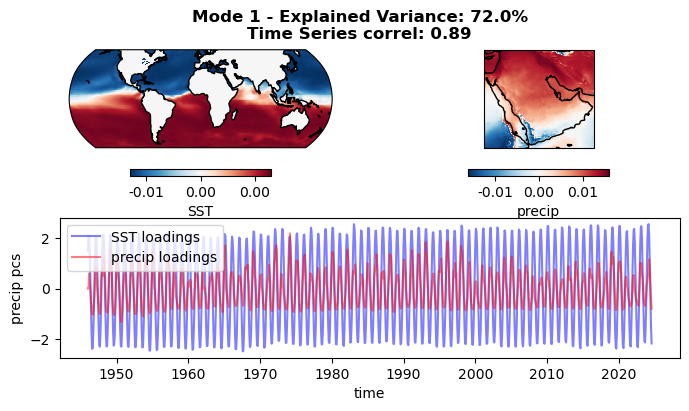

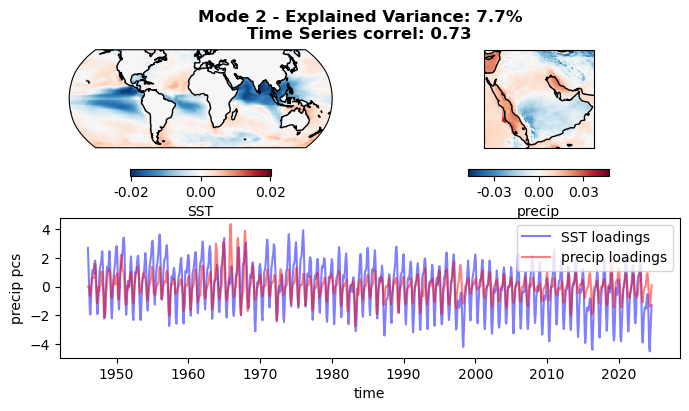

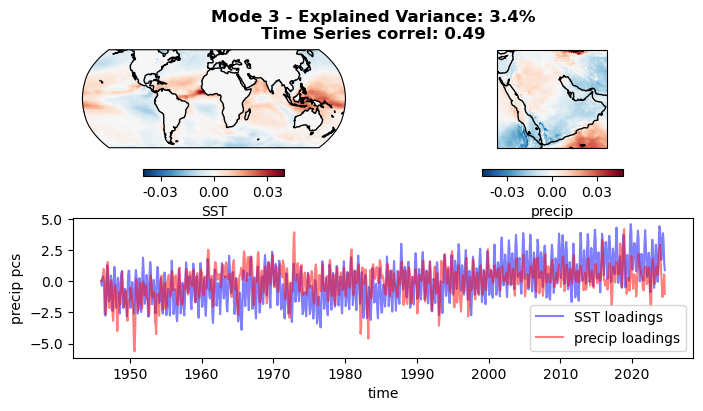

In [18]:
svd_analysis(era5, sst, n_modes=3)

In [8]:
class MCA:
    def __init__(self, X, Y,n_components=3):
        self.X = X
        self.Y = Y
        self.n_components = n_components
        self.fit()
        
    def fit(self):
        self.U, self.S, self.V = np.linalg.svd(self.X.T @ self.Y,full_matrices=True)
        self.U = self.U
        self.V = self.V
        self.S = self.S
        self.x_weights = self.U
        self.y_weights = self.V
        self.x_pcs = self.X @ self.x_weights
        self.y_pcs = self.Y @ self.y_weights

        self.skills = self.S**2 / np.sum(self.S**2)

In [40]:
sst_2d = sst.fillna(0).sst.values.reshape(sst.sst.shape[0], -1)
spi_2d = spi.fillna(0).spi.values.reshape(spi.spi.shape[0], -1)

mca = MCA(sst_2d, spi_2d)

In [41]:
mca.x_pcs.shape

(884, 3)

## PCA

In [93]:
def pca_analysis(spi, sst, n_components_spi=3, n_components_sst=3
                 , month=None):


    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        month = months.index(month)+1
        spi = spi.sel(time=spi['time.month']==month)
        sst = sst.sel(time=sst['time.month']==month)
    
    spi = (spi - spi.mean(dim='time')) / (spi.std(dim='time') + 1e-6)
    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)

    # Perform PCA and get components and explained variance ratios
    sst_2d = sst.fillna(0).sst.values.reshape(sst.sst.shape[0], -1)
    spi_2d = spi.fillna(0).spi.values.reshape(spi.spi.shape[0], -1)

    # sst_2d = (sst_2d - sst_2d.mean(axis=0)) / (sst_2d.std(axis=0)+1e-6)
    # spi_2d = (spi_2d - spi_2d.mean(axis=0)) / (spi_2d.std(axis=0)+1e-6)


    sst_pca = PCA(n_components=n_components_sst).fit(sst_2d)
    spi_pca = PCA(n_components=n_components_spi).fit(spi_2d)

    sst_pcs = sst_pca.transform(sst_2d)
    spi_pcs = spi_pca.transform(spi_2d)

    sst_weights = sst_pca.components_
    spi_weights = spi_pca.components_

    sst_explained_var = sst_pca.explained_variance_ratio_
    spi_explained_var = spi_pca.explained_variance_ratio_

    # Ensure the time values are properly formatted as datetime objects
    sst_times = pd.to_datetime(sst.time.values)
    spi_times = pd.to_datetime(spi.time.values)

    # Create dataframes for the PCs with datetime index
    sst_pcs_df = pd.DataFrame(sst_pcs, columns=[f'PC{i+1}' for i in range(3)], index=sst.time.values)
    spi_pcs_df = pd.DataFrame(spi_pcs, columns=[f'PC{i+1}' for i in range(3)], index=spi.time.values)


    for i in range(3):
        plt.figure(figsize=(6, 5))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())

        # Reshape the weights for sst and SPI to 2D maps (assuming original spatial dimensions)
        sst_reshaped = xr.DataArray(sst_weights[i].reshape(sst.sst.shape[1], sst.sst.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': sst.lat, 'lon': sst.lon})

        spi_reshaped = xr.DataArray(spi_weights[i].reshape(spi.spi.shape[1], spi.spi.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': spi.lat, 'lon': spi.lon})


        sst_reshaped.plot(ax=ax1, cmap='RdBu_r',add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5,
                                                                                                                            'label': 'SST',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            'format':'%.2f'})
        ax1.coastlines()
        ax1.set_title(f"Explained Var: {sst_explained_var[i]:.1%}", fontweight='bold')


        spi_reshaped.plot(ax=ax2, transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, cbar_kwargs={'shrink': 0.5,
                                                                                                                            'label': 'SPI',
                                                                                                                            'orientation': 'horizontal',
                                                                                                                            'format':'%.2f'})
        ax2.coastlines()
        ax2.set_title(f"Explained Var: {spi_explained_var[i]:.1%}", fontweight='bold')

        if month is not None:
            plt.suptitle(f'PC{i+1}: {months[month-1]}',fontweight='bold')
        else:
            plt.suptitle(f'PC{i+1}',fontweight='bold')

        plt.show()


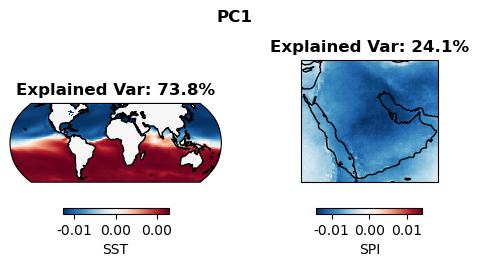

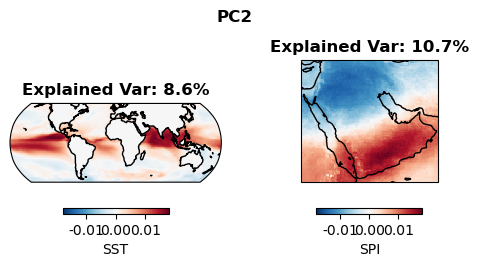

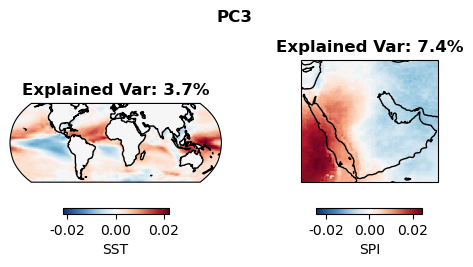

In [94]:
pca_analysis(spi, sst, 3, 3)

## CCA

In [107]:
def cca_analysis(spi, sst, n_components=3, month=None):

    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        num_month = months.index(month) + 1
        spi = spi.sel(time=spi.time.dt.month==num_month)
        sst = sst.sel(time=sst.time.dt.month==num_month)
    
    spi = (spi - spi.mean(dim='time')) / (spi.std(dim='time') + 1e-6)
    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)
    

    spi_2d = spi.fillna(0).spi.values.reshape(spi.spi.shape[0], -1)
    sst_2d = sst.fillna(0).sst.values.reshape(sst.sst.shape[0], -1)

    # spi_2d = (spi_2d - spi_2d.mean(axis=0)) / (spi_2d.std(axis=0) + 1e-6)
    # sst_2d = (sst_2d - sst_2d.mean(axis=0)) / (sst_2d.std(axis=0) + 1e-6)


    cca = CCA(n_components=n_components)
    cca.fit(sst_2d, spi_2d)

    sst_cca, spi_cca = cca.transform(sst_2d, spi_2d)

    # Create dataframes for the CCA components with datetime index
    sst_cca_df = pd.DataFrame(sst_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)
    spi_cca_df = pd.DataFrame(spi_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)

    for i in range(3):
        plt.figure(figsize=(6, 5))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())
        
        # Reshape the weights for sst and SPI to 2D maps (assuming original spatial dimensions)
        sst_reshaped = xr.DataArray(cca.x_loadings_[:, i].reshape(sst.sst.shape[1], sst.sst.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': sst.lat, 'lon': sst.lon})

        spi_reshaped = xr.DataArray(cca.y_loadings_[:, i].reshape(spi.spi.shape[1], spi.spi.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': spi.lat, 'lon': spi.lon})


        sst_reshaped.plot(ax=ax1, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5, 'label': 'SST',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'}
                    )
        ax1.coastlines()
        ax1.set_title(f"")

        spi_reshaped.plot(ax=ax2, transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, cbar_kwargs={'shrink': 0.5, 'label': 'SPI',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'}
                    )
        ax2.coastlines()
        ax2.set_title(f"")

        if month is not None:
            plt.suptitle(f"CCA Mode {i+1} {month}", fontweight='bold')
        else:
            plt.suptitle(f"CCA Mode {i+1}", fontweight='bold')
    
        plt.show()



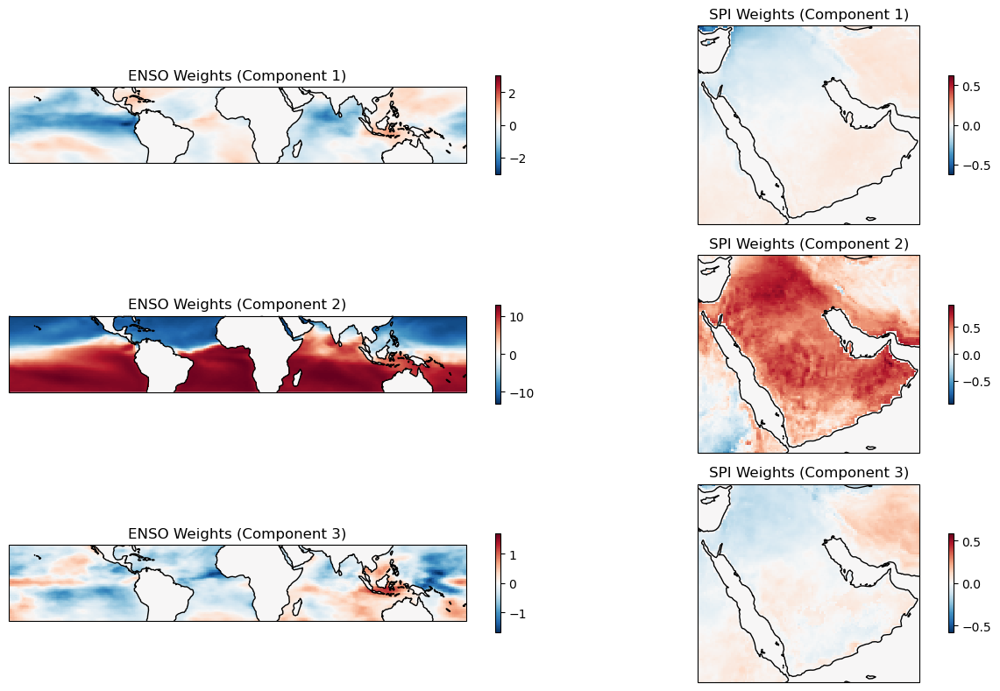

In [73]:
cca_analysis(spi, sst, 3)

## Denoised CCA

In [112]:
def denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=10, n_pcs_spi=10, month=None):

    if month is not None:
        months = ['NDJ', 'DJF', 'JFM', 'FMA', 'MAM', 'AMJ', 'MJJ', 'JJA', 'JAS', 'ASO', 'SON', 'OND']
        num_month = months.index(month) + 1
        spi = spi.sel(time=spi.time.dt.month==num_month)
        sst = sst.sel(time=sst.time.dt.month==num_month)
    
    spi = (spi - spi.mean(dim='time')) / (spi.std(dim='time') + 1e-6)
    sst = (sst - sst.mean(dim='time')) / (sst.std(dim='time') + 1e-6)
    
    spi_2d = spi.fillna(0).spi.values.reshape(spi.spi.shape[0], -1)
    sst_2d = sst.fillna(0).sst.values.reshape(sst.sst.shape[0], -1)

    # spi_2d = (spi_2d - spi_2d.mean(axis=0)) / (spi_2d.std(axis=0) + 1e-6)
    # sst_2d = (sst_2d - sst_2d.mean(axis=0)) / (sst_2d.std(axis=0) + 1e-6)

    pca_sst = PCA(n_components=n_pcs_sst).fit(sst_2d)
    pca_spi = PCA(n_components=n_pcs_spi).fit(spi_2d)


    sst_pcs = pca_sst.transform(sst_2d) 
    spi_pcs = pca_spi.transform(spi_2d) 

    sst_denoised = pca_sst.inverse_transform(sst_pcs) 
    spi_denoised = pca_spi.inverse_transform(spi_pcs)   

    # sst_denoised = (sst_denoised - sst_denoised.mean(axis=0)) / (sst_denoised.std(axis=0) + 1e-6)
    # spi_denoised = (spi_denoised - spi_denoised.mean(axis=0)) / (spi_denoised.std(axis=0) + 1e-6)


    cca = CCA(n_components=n_components_cca)
    cca.fit(sst_denoised, spi_denoised)

    sst_cca, spi_cca = cca.transform(sst_denoised, spi_denoised)

    # Create dataframes for the CCA components with datetime index
    sst_cca_df = pd.DataFrame(sst_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)
    spi_cca_df = pd.DataFrame(spi_cca, columns=[f'CCA{i+1}' for i in range(3)], index=spi.time.values)


    for i in range(3):
        plt.figure(figsize=(6, 5))
        ax1 = plt.subplot(2,2,1, projection=ccrs.Robinson())
        ax2 = plt.subplot(2,2,2, projection=ccrs.PlateCarree())
        
        # Reshape the weights for sst and SPI to 2D maps (assuming original spatial dimensions)
        sst_reshaped = xr.DataArray(cca.x_loadings_[:, i].reshape(sst.sst.shape[1], sst.sst.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': sst.lat, 'lon': sst.lon})

        spi_reshaped = xr.DataArray(cca.y_loadings_[:, i].reshape(spi.spi.shape[1], spi.spi.shape[2]), 
                                    dims=['lat', 'lon'], 
                                    coords={'lat': spi.lat, 'lon': spi.lon})


        sst_reshaped.plot(ax=ax1, cmap='RdBu_r', add_colorbar=True, transform=ccrs.PlateCarree(),cbar_kwargs={'shrink': 0.5, 'label': 'SST',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'})
        ax1.coastlines()
        ax1.set_title(f"")

        spi_reshaped.plot(ax=ax2, transform=ccrs.PlateCarree(), cmap='RdBu_r', add_colorbar=True, cbar_kwargs={'shrink': 0.5, 'label': 'SPI',
                                                                                                                'orientation': 'horizontal', 'format':'%.2f'})
        ax2.coastlines()
        ax2.set_title(f"")

        if month is not None:
            plt.suptitle(f"CCA Mode {i+1} {month}", fontweight='bold')
        else:
            plt.suptitle(f"CCA Mode {i+1}", fontweight='bold')
    
        plt.show()

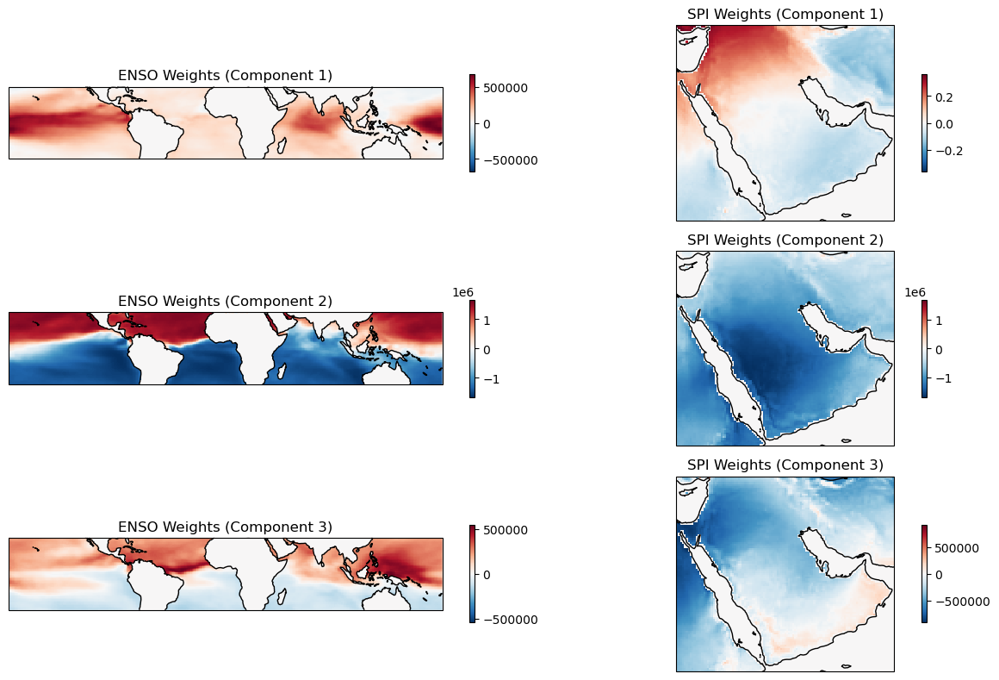

In [65]:
denoised_cca_analysis(spi, sst)

In [17]:
spi_cpt = spi.spi.fillna(0).rename({'time':'T', 'lat':'Y', 'lon':'X'}).transpose('T', 'Y', 'X')
#start from 1981
spi_cpt = spi_cpt.sel(T=slice('1981-01-01', '2024-12-01'))

spi_cpt.attrs['units'] = 'unitless'
spi_cpt.attrs['missing'] = '-999'
spi_cpt.attrs['nrows'] = spi_cpt.shape[1]
spi_cpt.attrs['ncols'] = spi_cpt.shape[2]
spi_cpt.attrs['row'] = 'Y'
spi_cpt.attrs['col'] = 'X'
spi_cpt.attrs['standard_name'] = 'SPI'

sst_cpt = sst.sst.fillna(0).isel(time=slice(None,-1)).rename({'time':'T', 'lat':'Y', 'lon':'X'}).transpose('T', 'Y', 'X')
sst_cpt = sst_cpt.sel(T=slice('1981-01-01', '2024-12-01'))
sst_cpt.attrs['units'] = 'celsius'
sst_cpt.attrs['missing'] = '999'
sst_cpt.attrs['nrows'] = sst_cpt.shape[1]
sst_cpt.attrs['ncols'] = sst_cpt.shape[2]
sst_cpt.attrs['row'] = 'Y'
sst_cpt.attrs['col'] = 'X'
sst_cpt.attrs['standard_name'] = 'SST'

hindcasts, forecasts, skills, patterns_x, patterns_y = cc.canonical_correlation_analysis(sst_cpt, spi_cpt)

CPTError: 
PROCESS STATUS: ALIVE (WILL BE STOPPED)
  last command: 'C:\Users\emile\.pycpt_workspace\3bd7446b-82d0-4a5f-a872-d9a7ee2db0a3\original_predictor'
  last message:'Error
  
 ERROR:  Unable to open monthly X files
 CPT '


# Monthly

## SVD

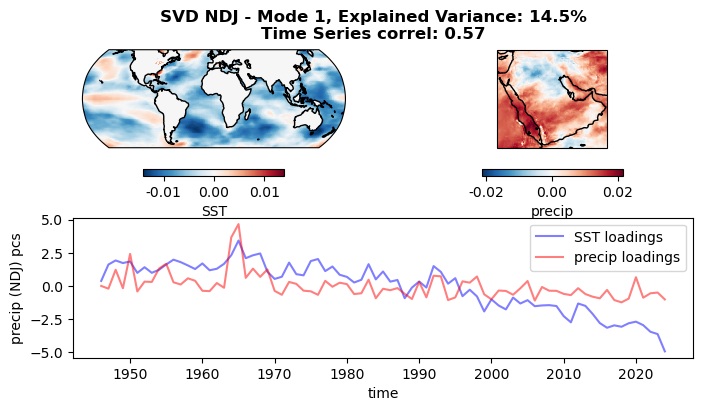

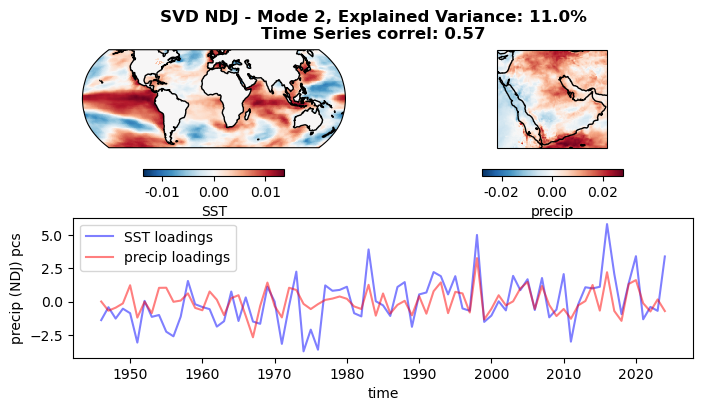

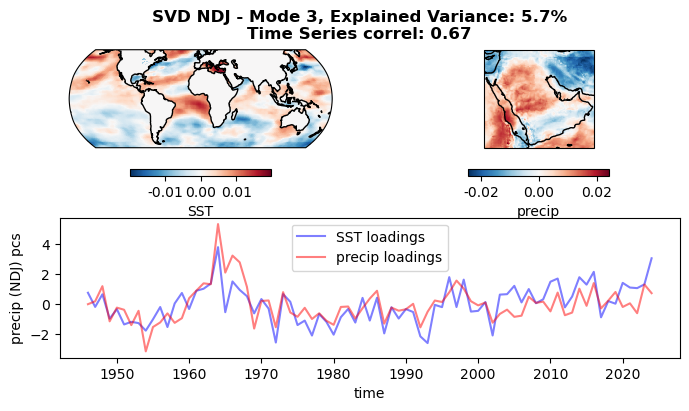

In [6]:
svd_analysis(era5, sst, n_modes=3, month='NDJ')

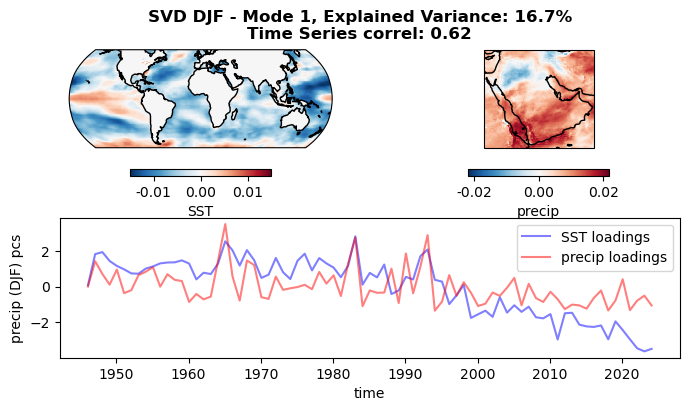

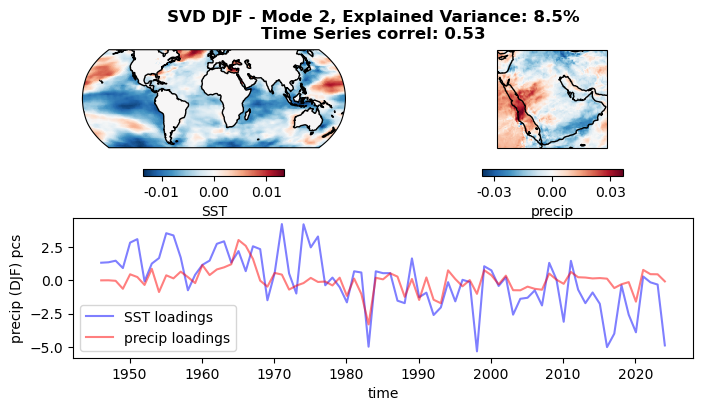

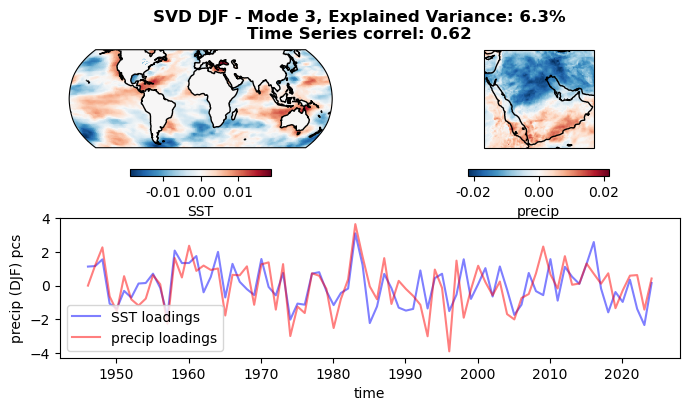

In [7]:
svd_analysis(era5, sst, month='DJF')

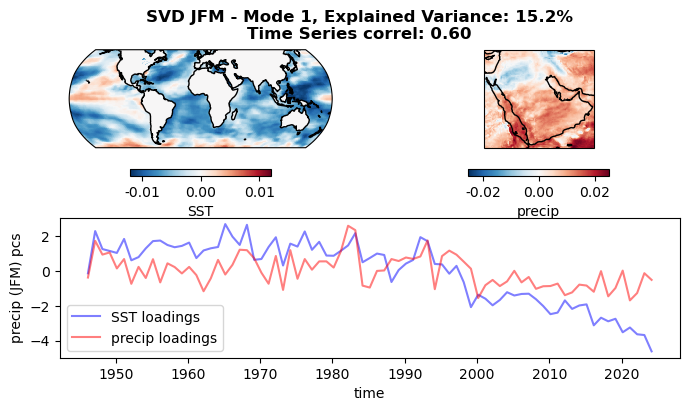

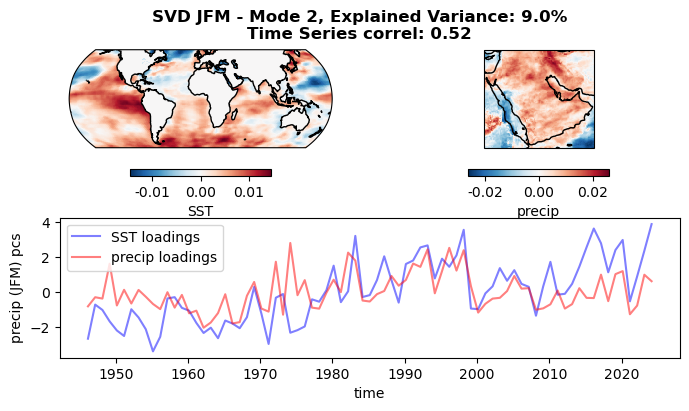

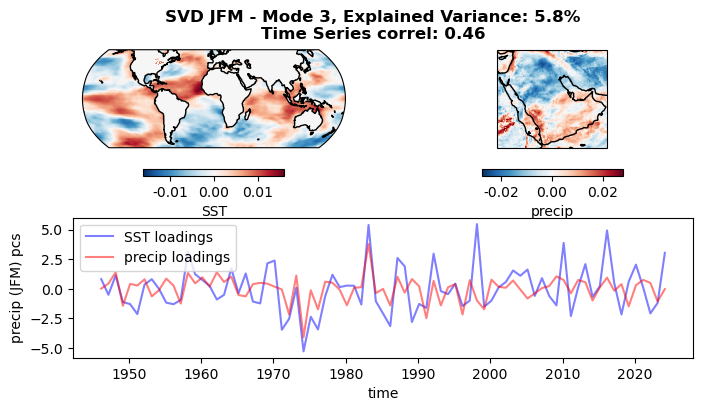

In [8]:
svd_analysis(era5, sst, month='JFM')

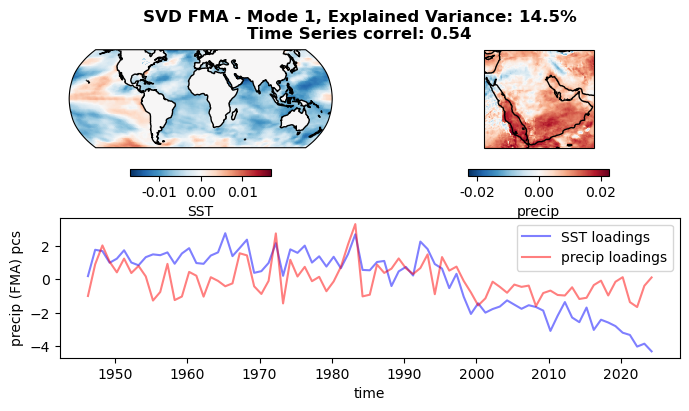

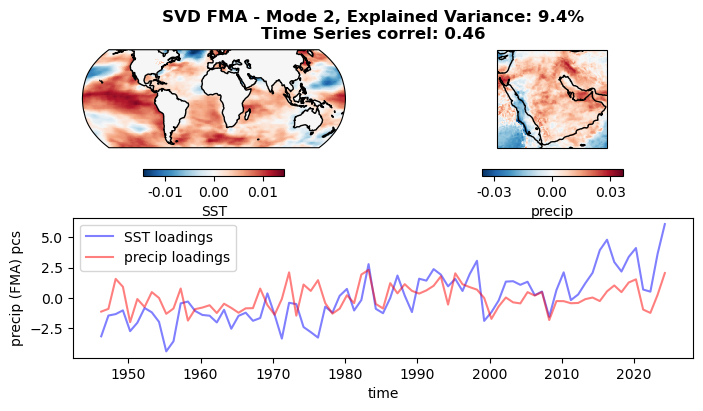

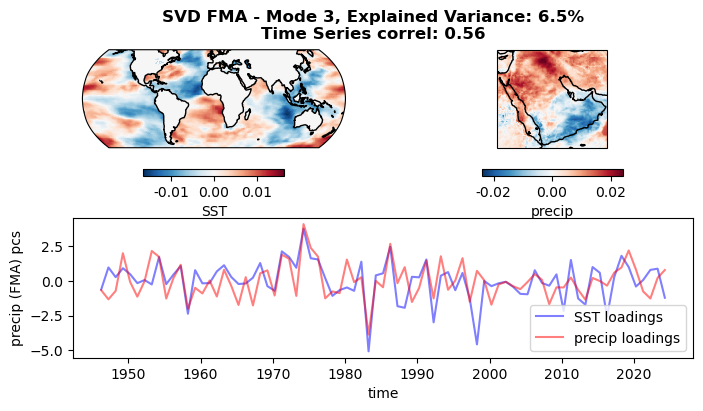

In [9]:
svd_analysis(era5, sst, month='FMA')

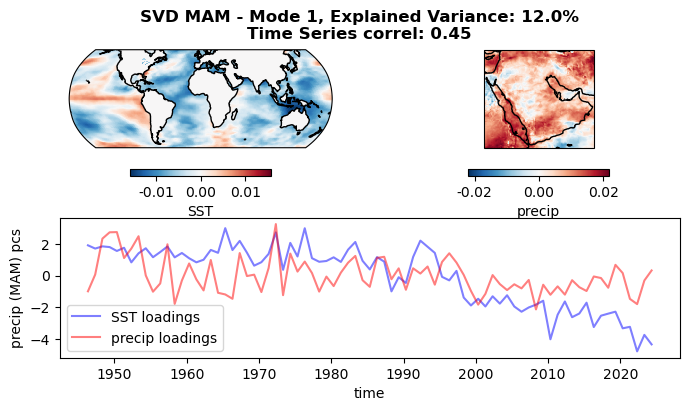

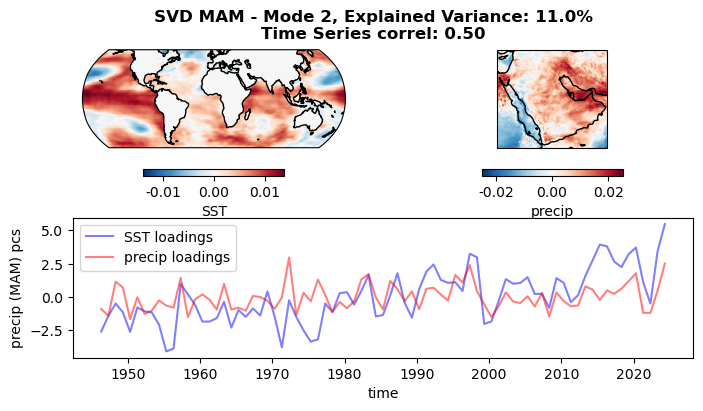

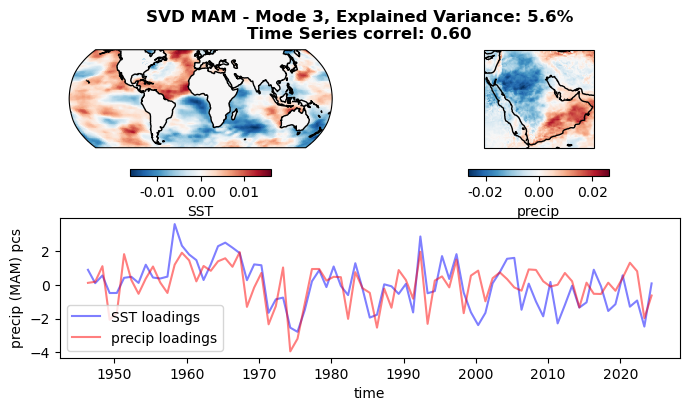

In [10]:
svd_analysis(era5, sst, month='MAM')

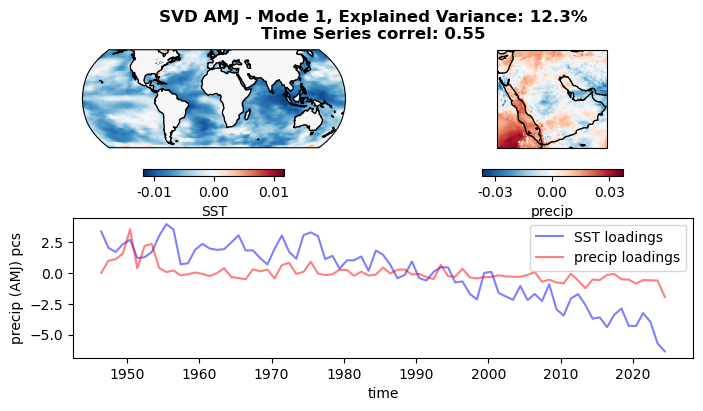

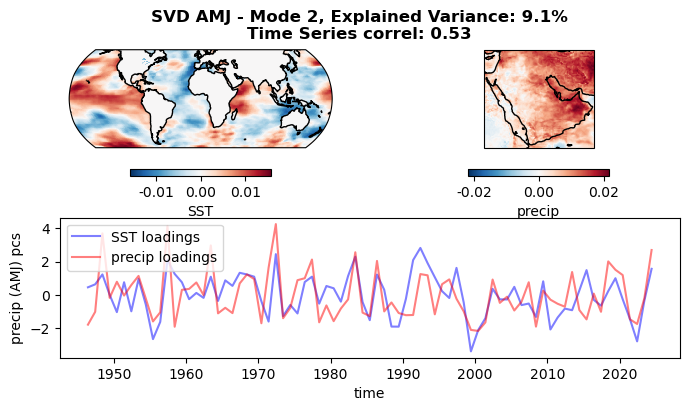

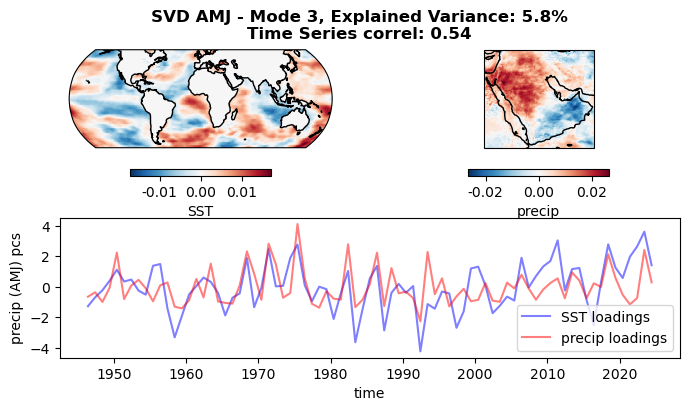

In [11]:
svd_analysis(era5, sst, month='AMJ')

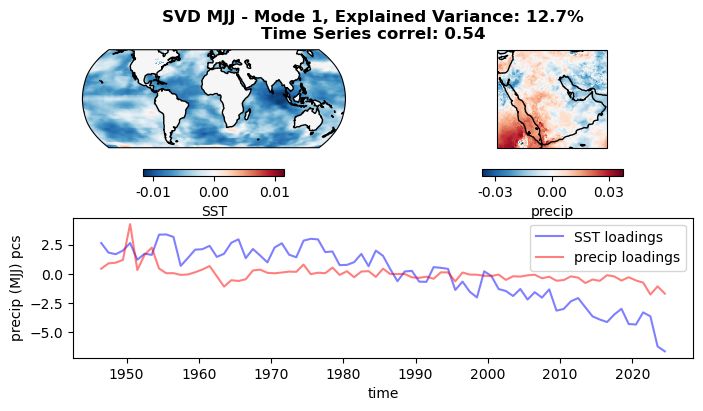

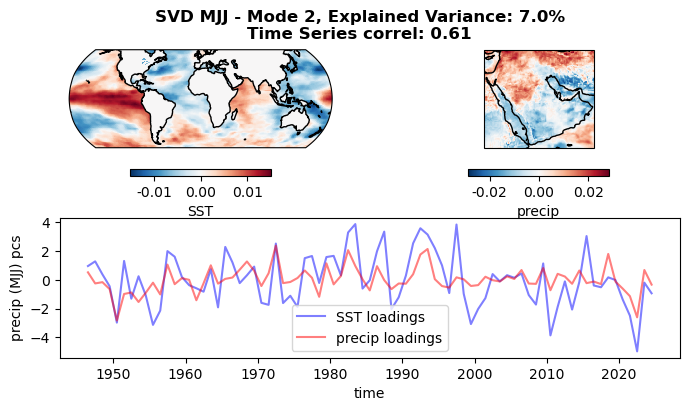

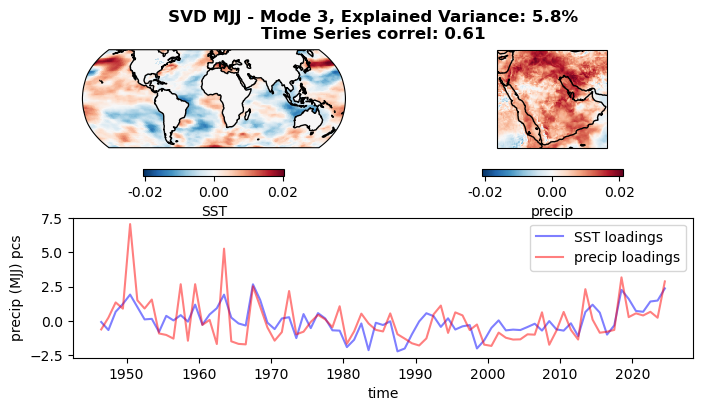

In [12]:
svd_analysis(era5, sst, month='MJJ')

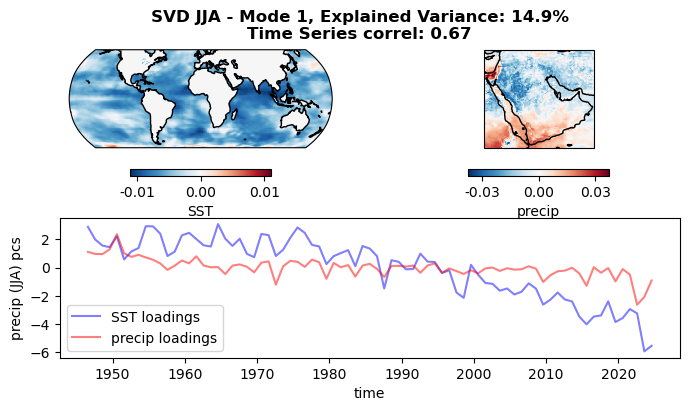

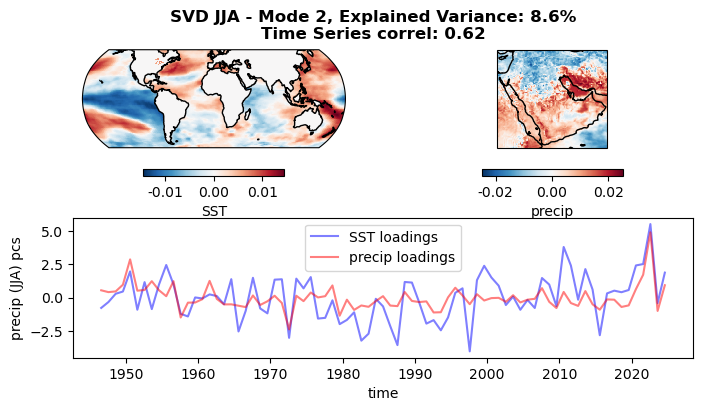

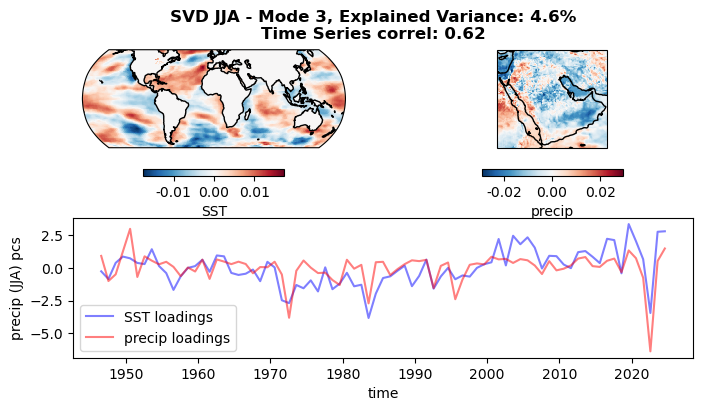

In [13]:
svd_analysis(era5, sst, month='JJA')

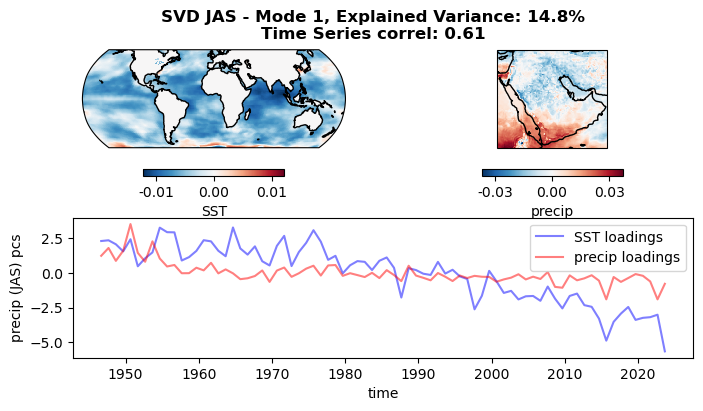

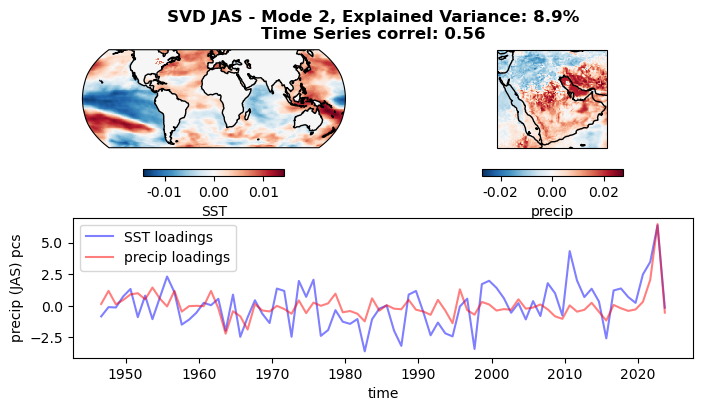

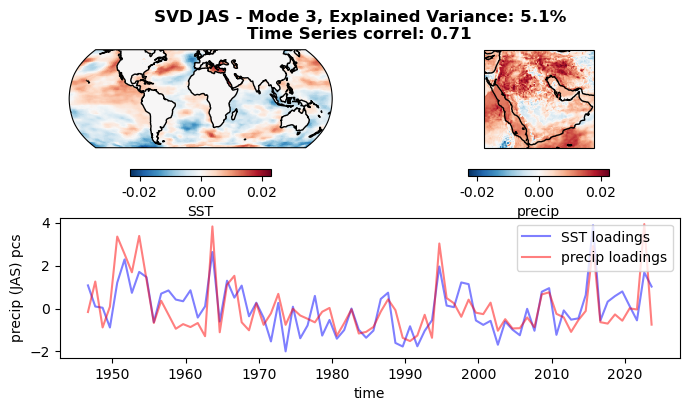

In [14]:
svd_analysis(era5, sst, month='JAS')

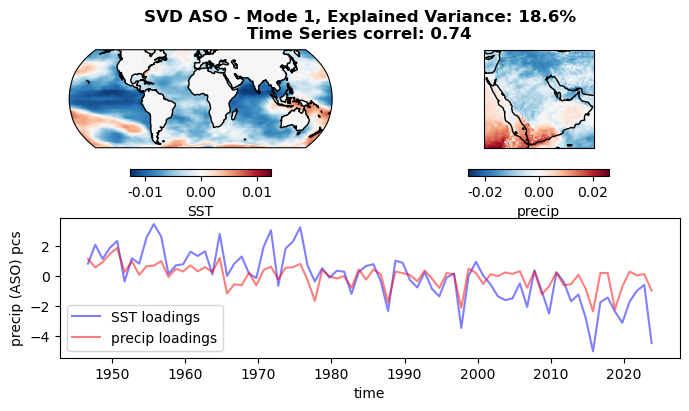

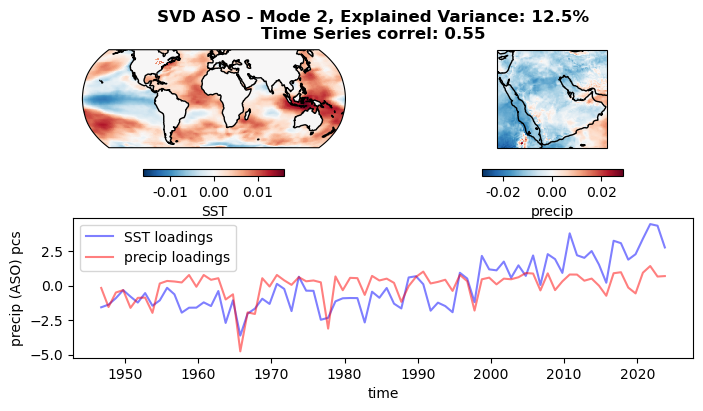

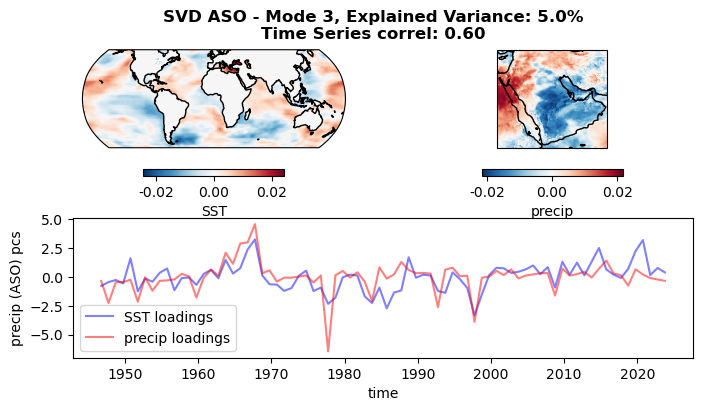

In [15]:
svd_analysis(era5, sst, month='ASO')

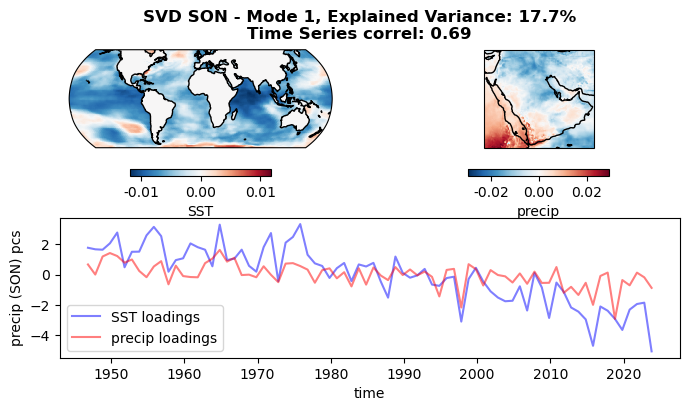

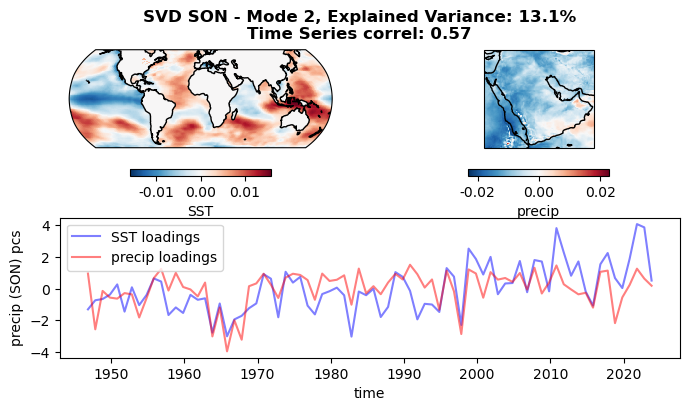

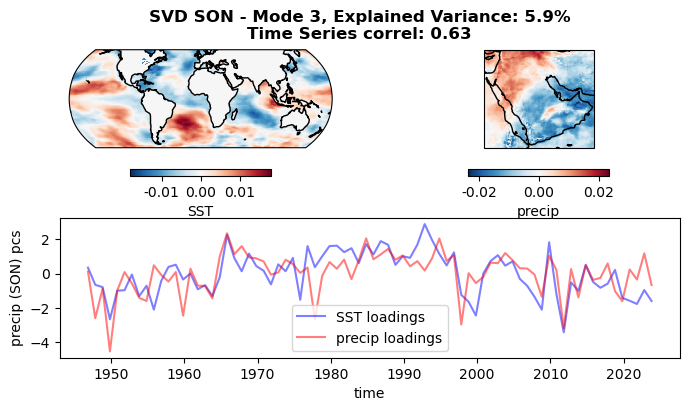

In [16]:
svd_analysis(era5, sst, month='SON')

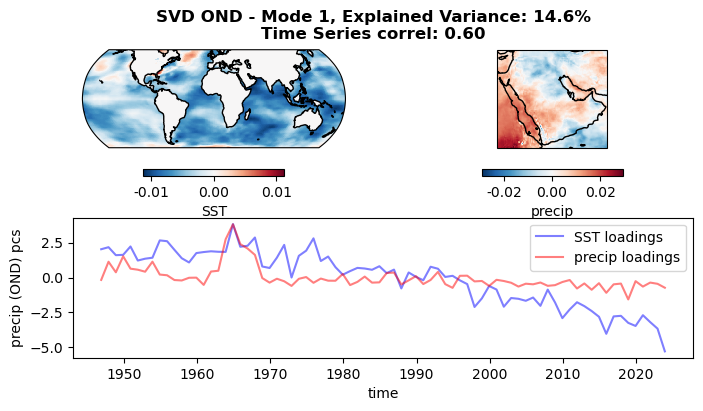

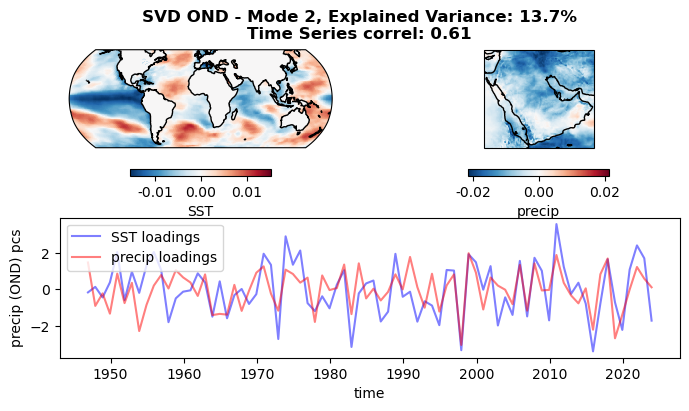

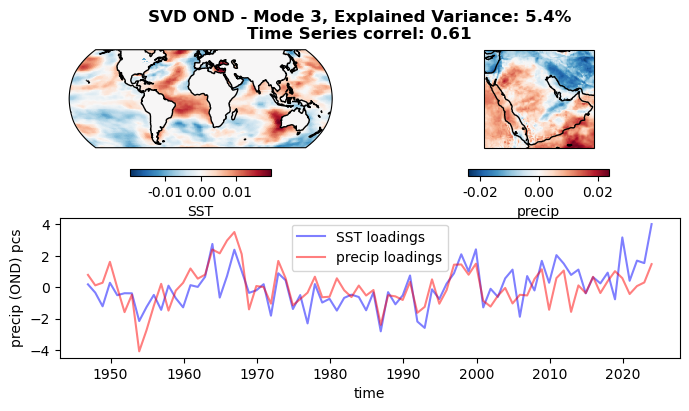

In [17]:
svd_analysis(era5, sst, month='OND')

## PCA

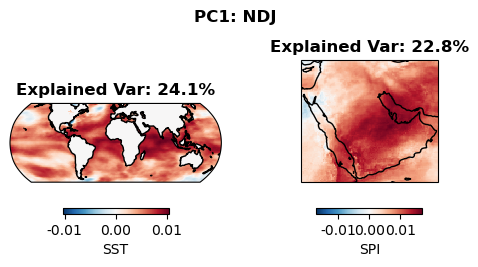

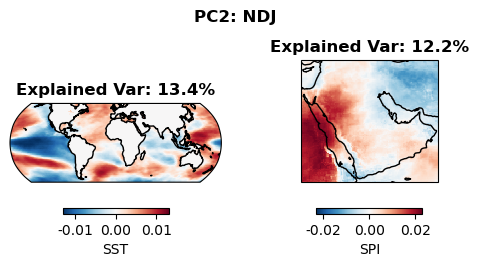

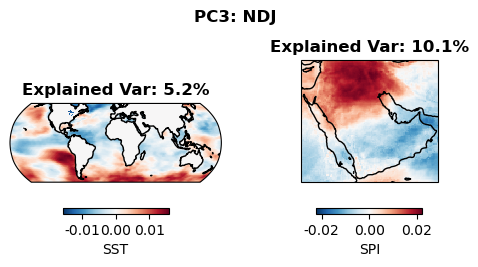

In [95]:
pca_analysis(spi, sst, 3, 3, month='NDJ')

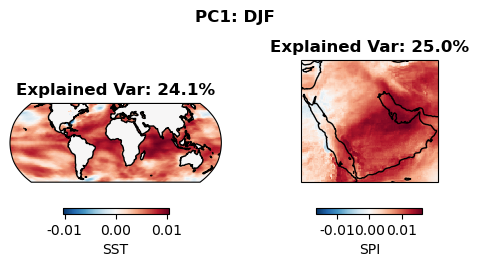

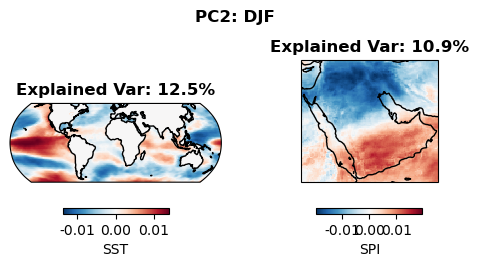

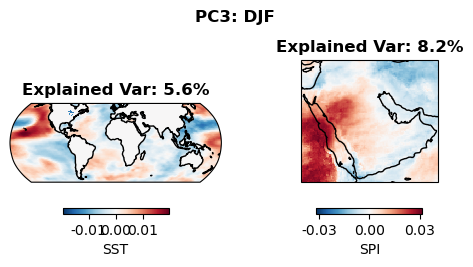

In [96]:
pca_analysis(spi, sst, 3, 3, month='DJF')

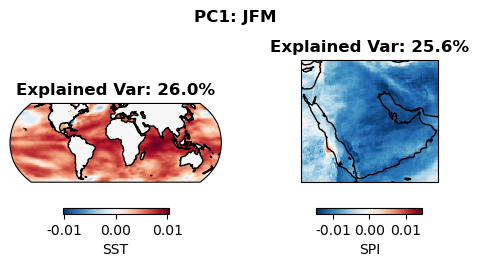

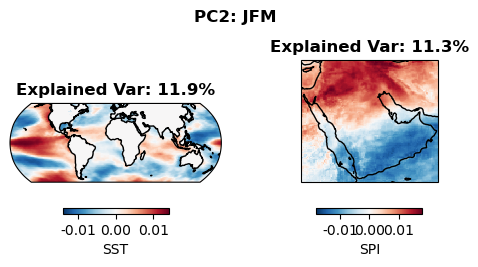

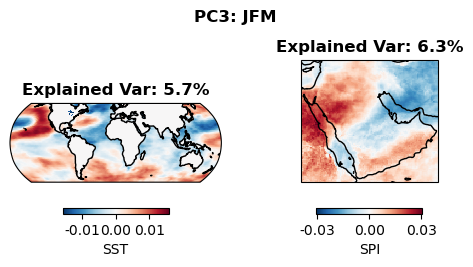

In [97]:
pca_analysis(spi, sst, 3, 3, month='JFM')

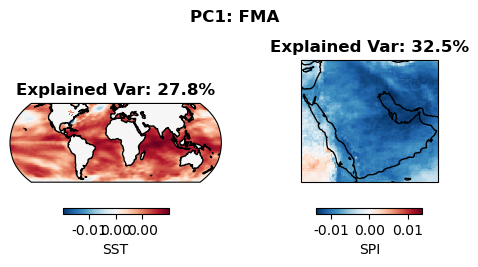

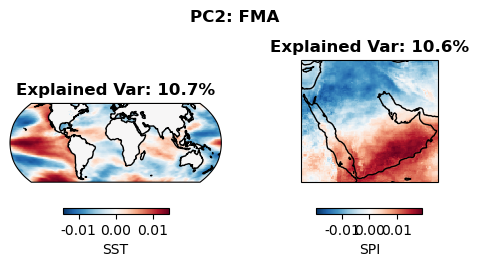

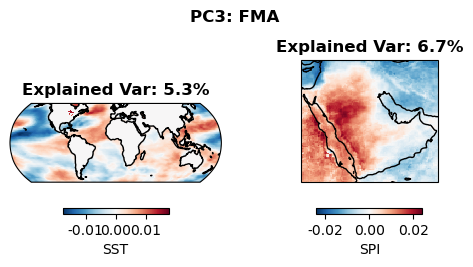

In [98]:
pca_analysis(spi, sst, 3, 3, month='FMA')

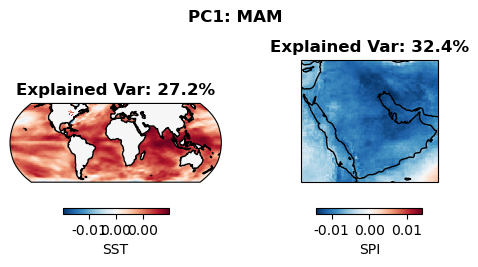

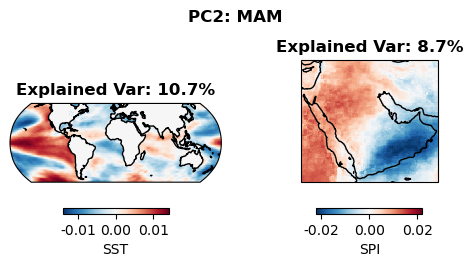

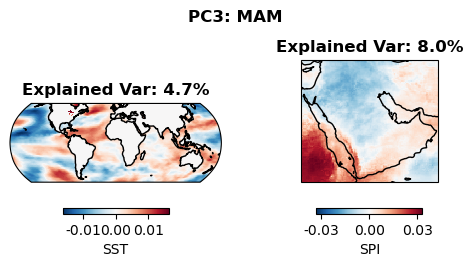

In [99]:
pca_analysis(spi, sst, 3, 3, month='MAM')

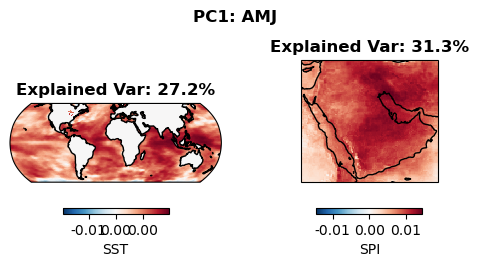

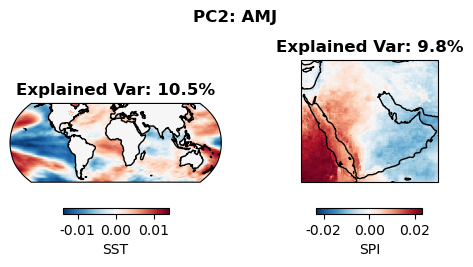

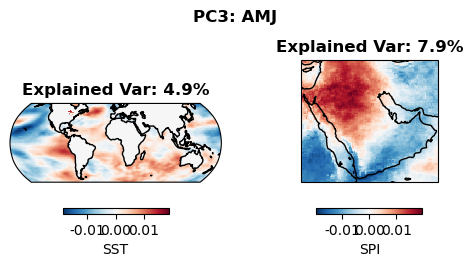

In [100]:
pca_analysis(spi, sst, 3, 3, month='AMJ')

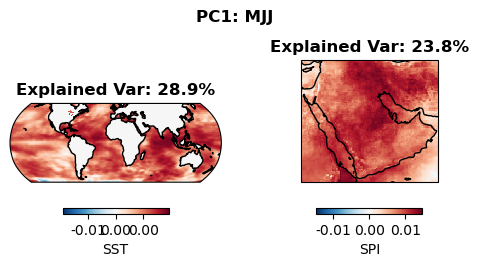

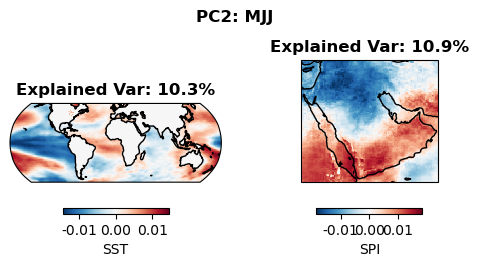

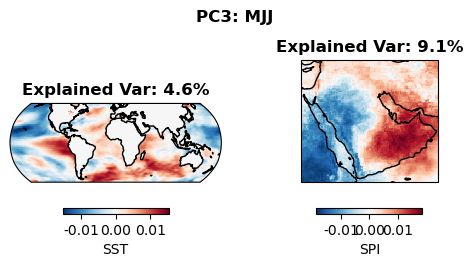

In [101]:
pca_analysis(spi, sst, 3, 3, month='MJJ')

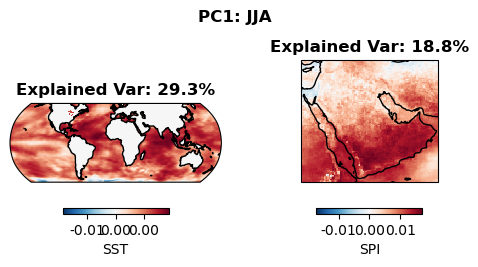

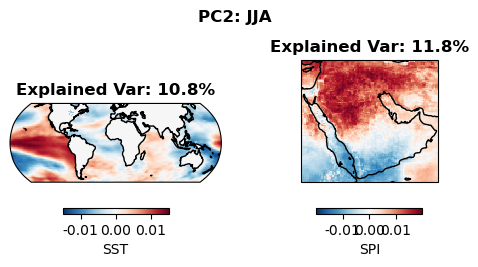

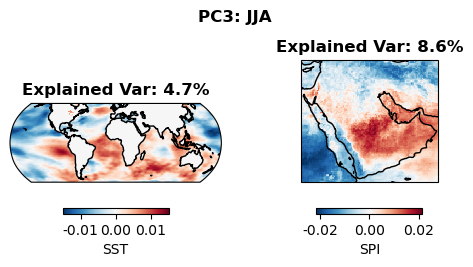

In [102]:
pca_analysis(spi, sst, 3, 3, month='JJA')

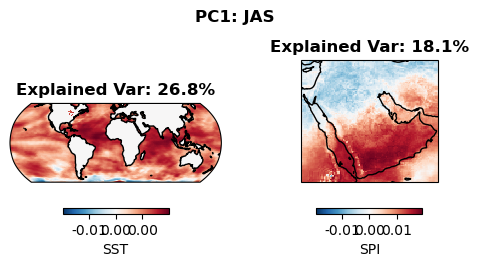

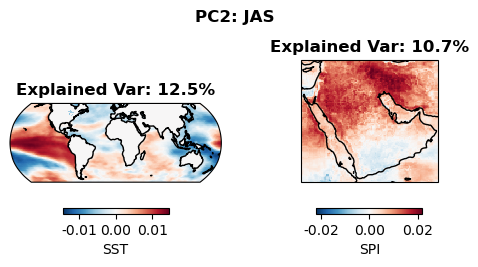

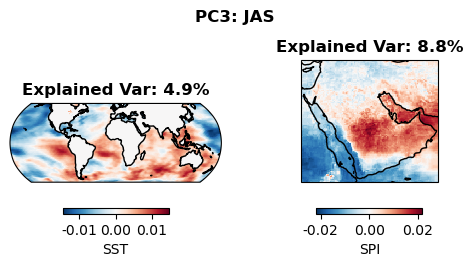

In [103]:
pca_analysis(spi, sst, 3, 3, month='JAS')

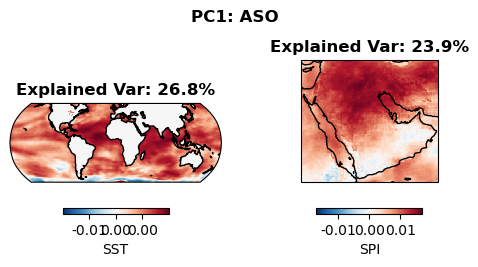

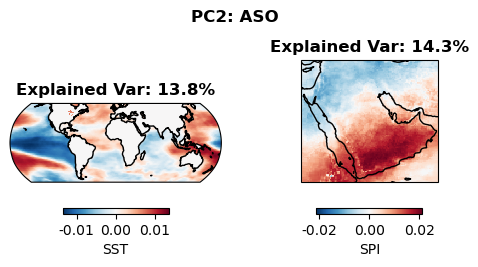

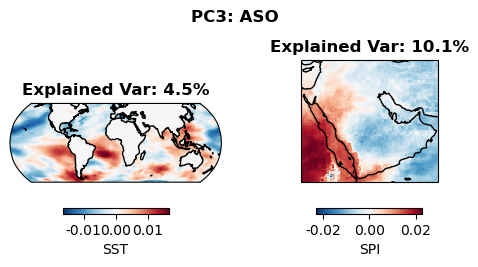

In [104]:
pca_analysis(spi, sst, 3, 3, month='ASO')

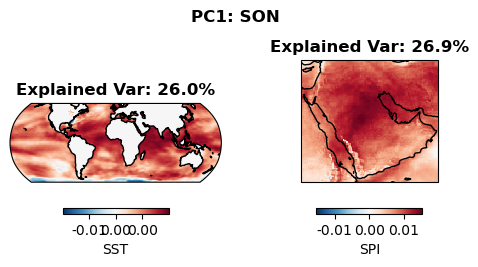

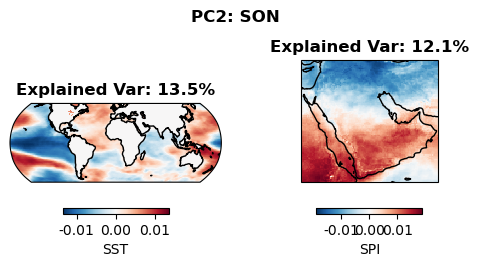

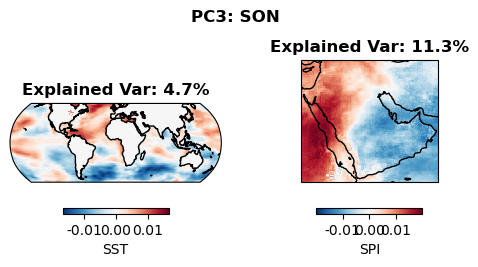

In [105]:
pca_analysis(spi, sst, 3, 3, month='SON')

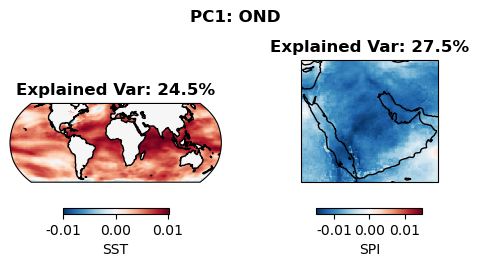

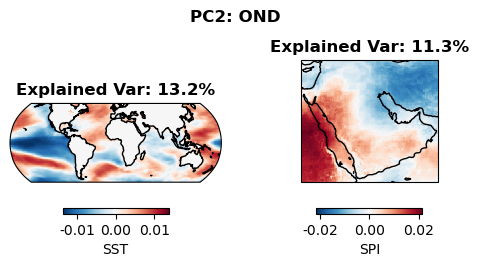

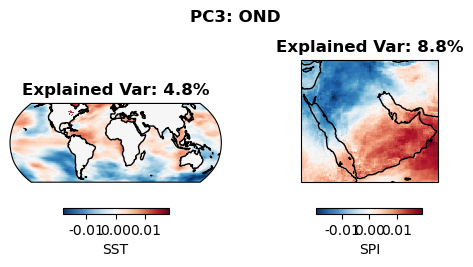

In [106]:
pca_analysis(spi, sst, 3, 3, month='OND')

## CCA

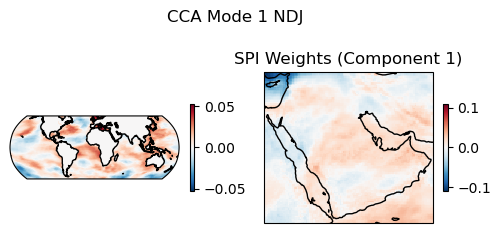

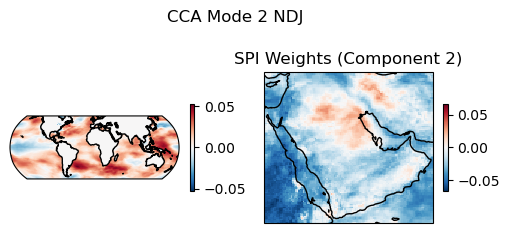

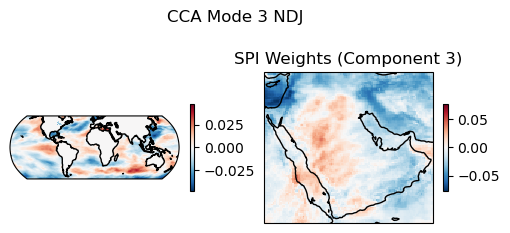

In [108]:
cca_analysis(spi, sst, 3, month='NDJ')

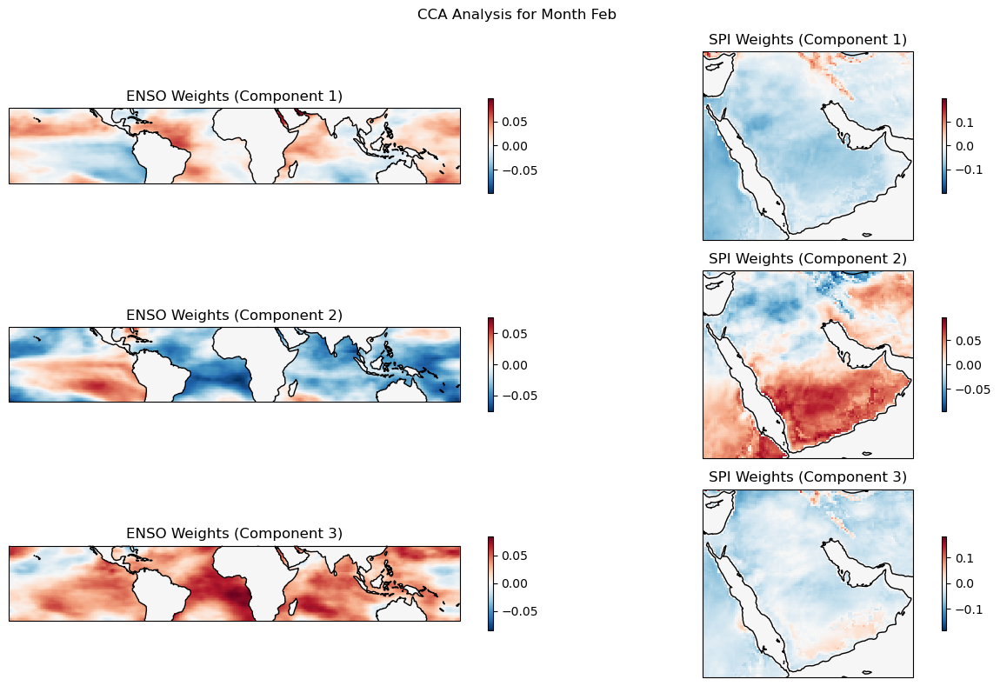

In [115]:
cca_analysis(spi, sst, 3, month='Feb')

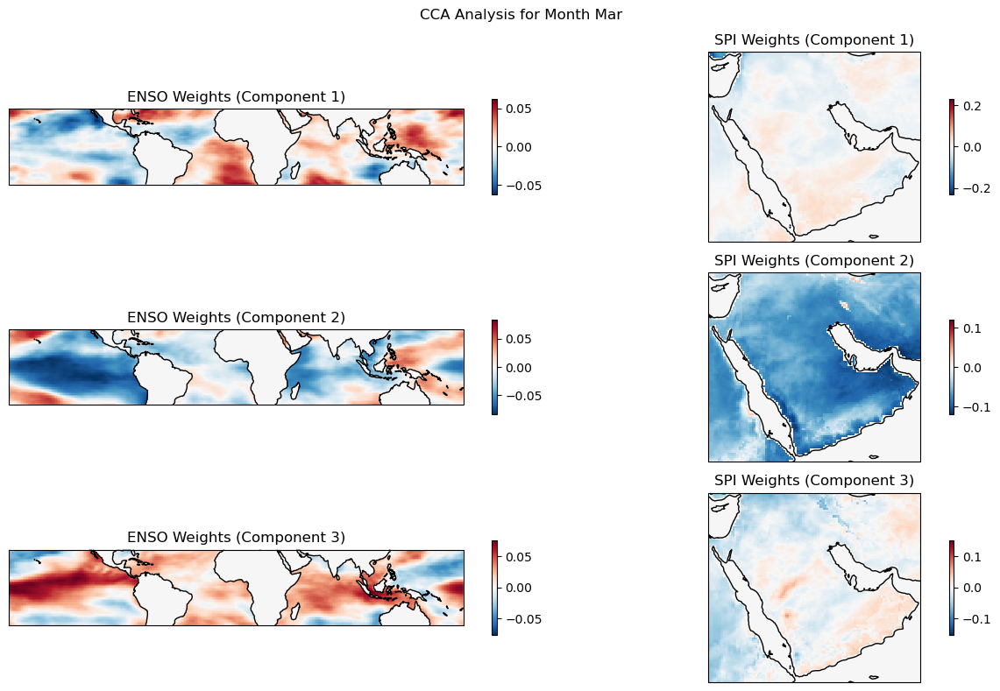

In [116]:
cca_analysis(spi, sst, 3, month='Mar')

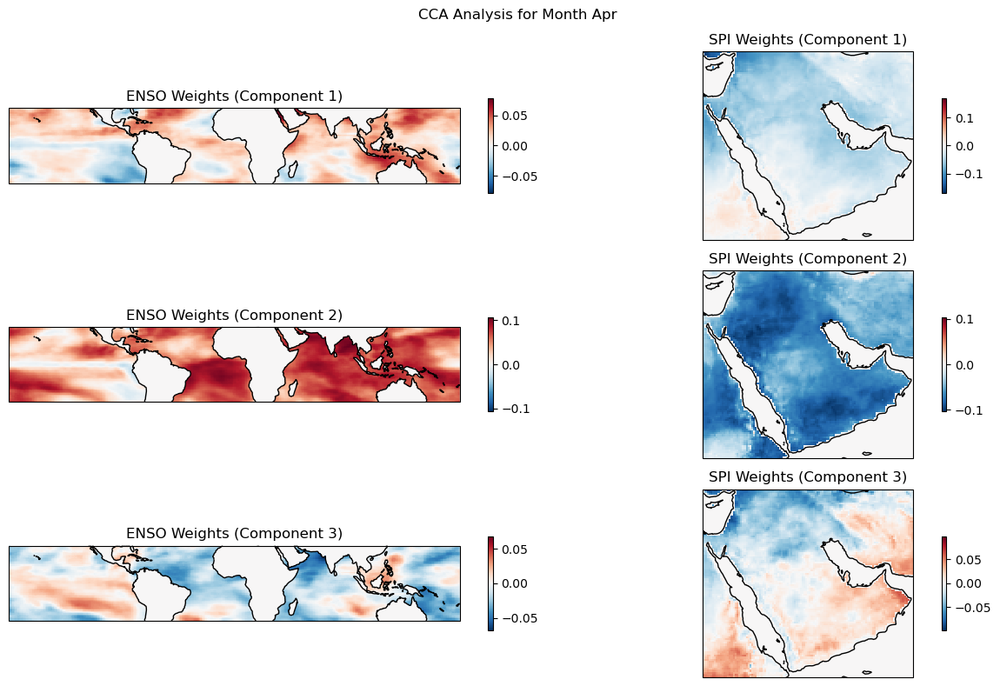

In [117]:
cca_analysis(spi, sst, 3, month='Apr')

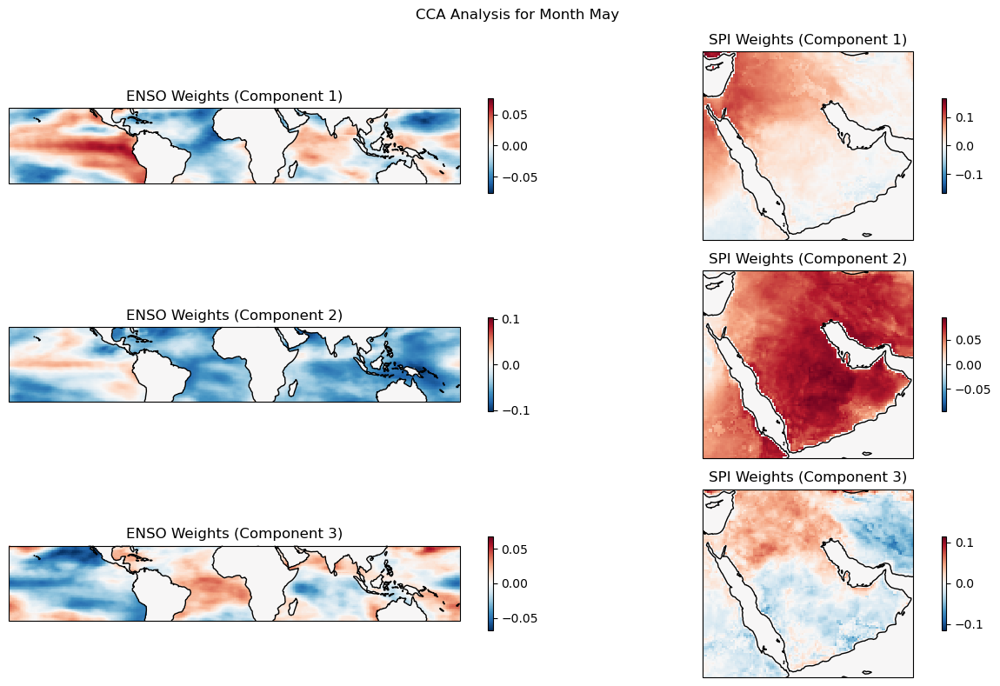

In [118]:
cca_analysis(spi, sst, 3, month='May')

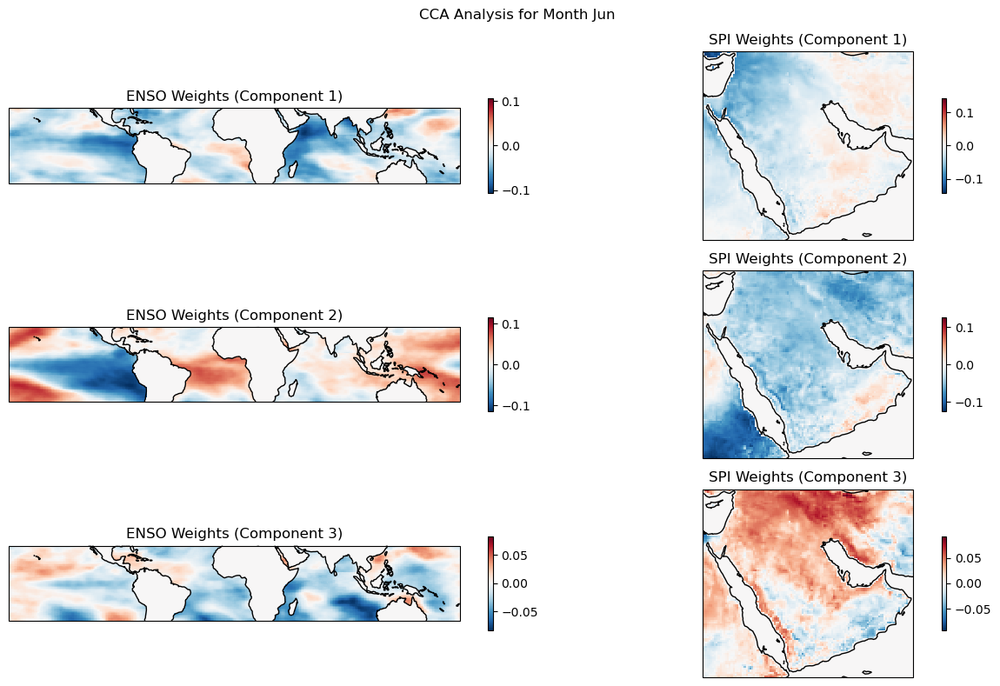

In [119]:
cca_analysis(spi, sst, 3, month='Jun')

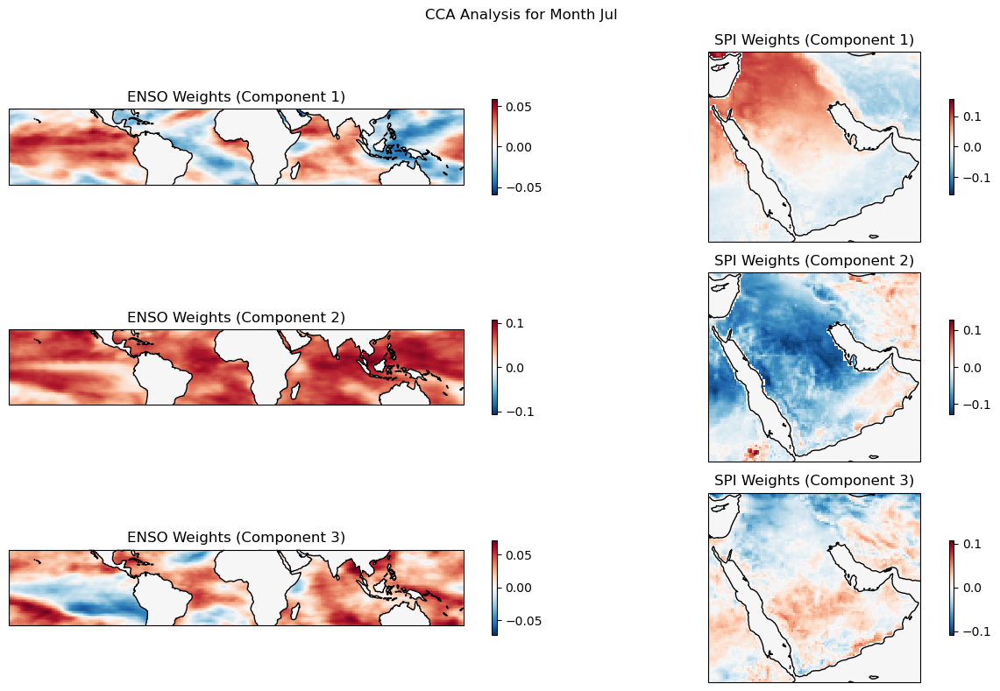

In [120]:
cca_analysis(spi, sst, 3, month='Jul')

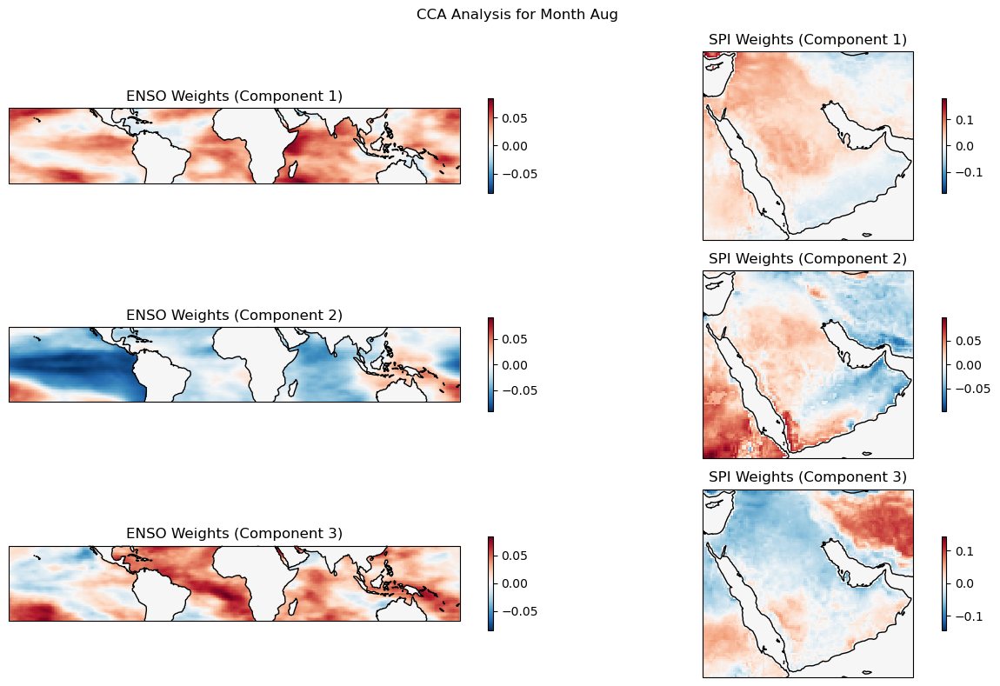

In [121]:
cca_analysis(spi, sst, 3, month='Aug')

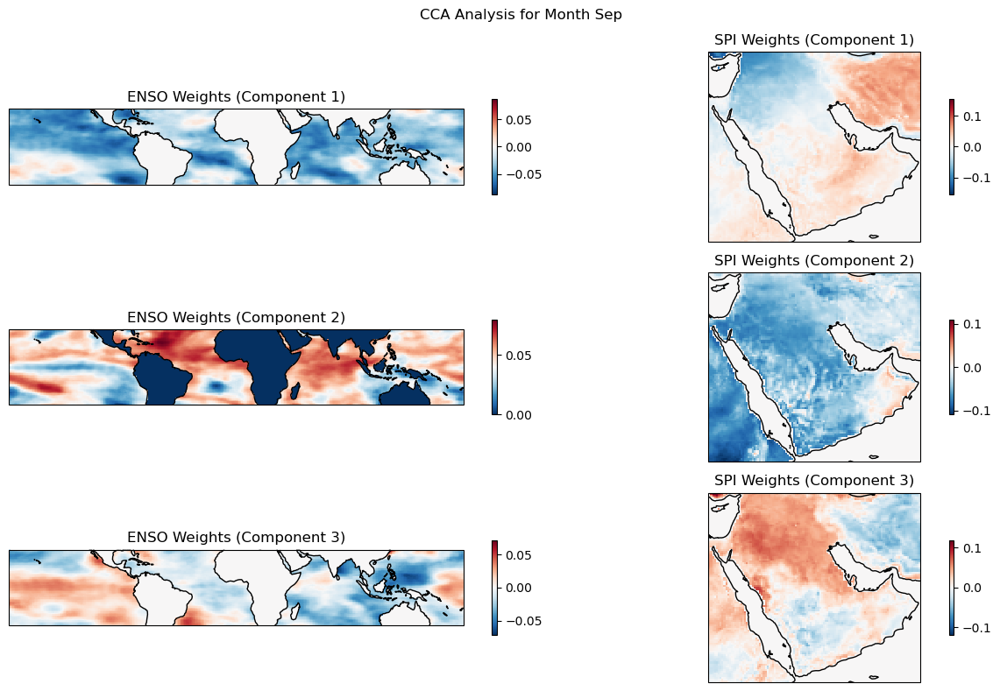

In [122]:
cca_analysis(spi, sst, 3, month='Sep')

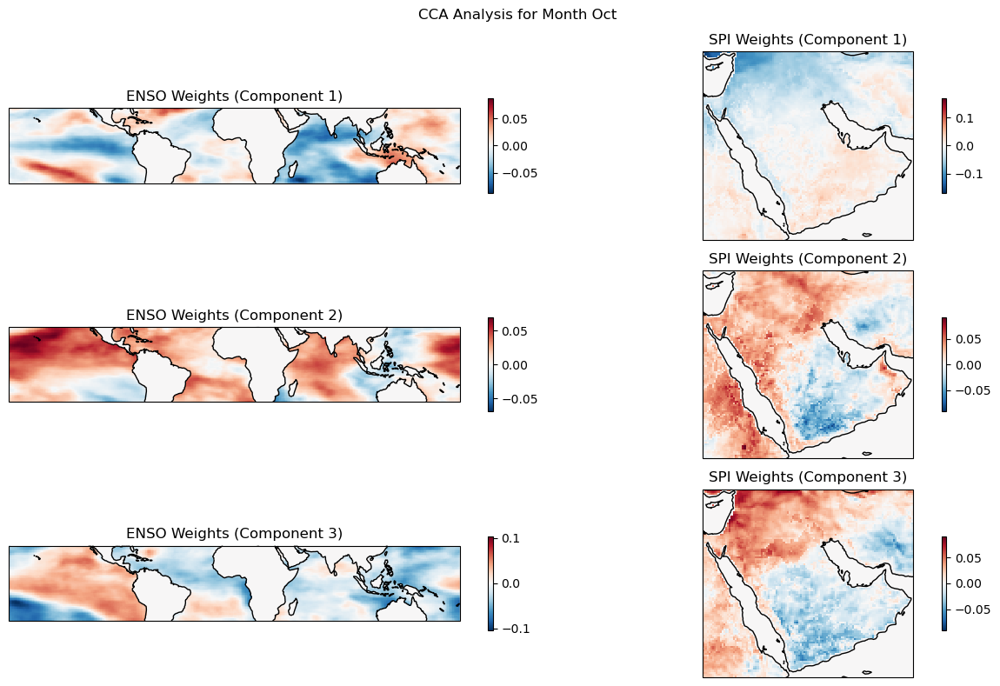

In [123]:
cca_analysis(spi, sst, 3, month='Oct')

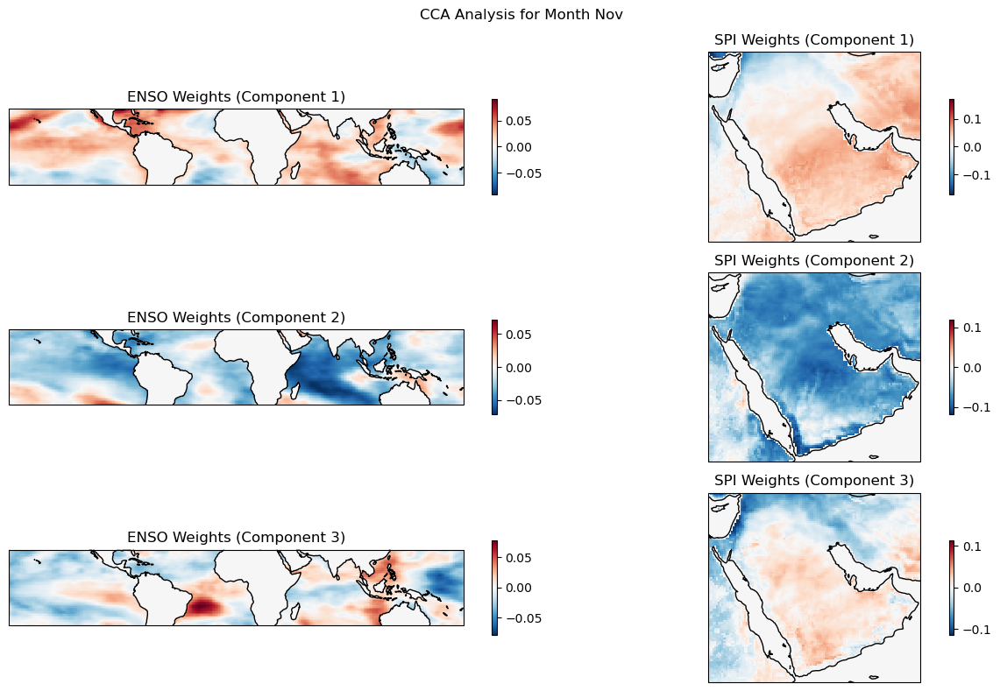

In [124]:
cca_analysis(spi, sst, 3, month='Nov')

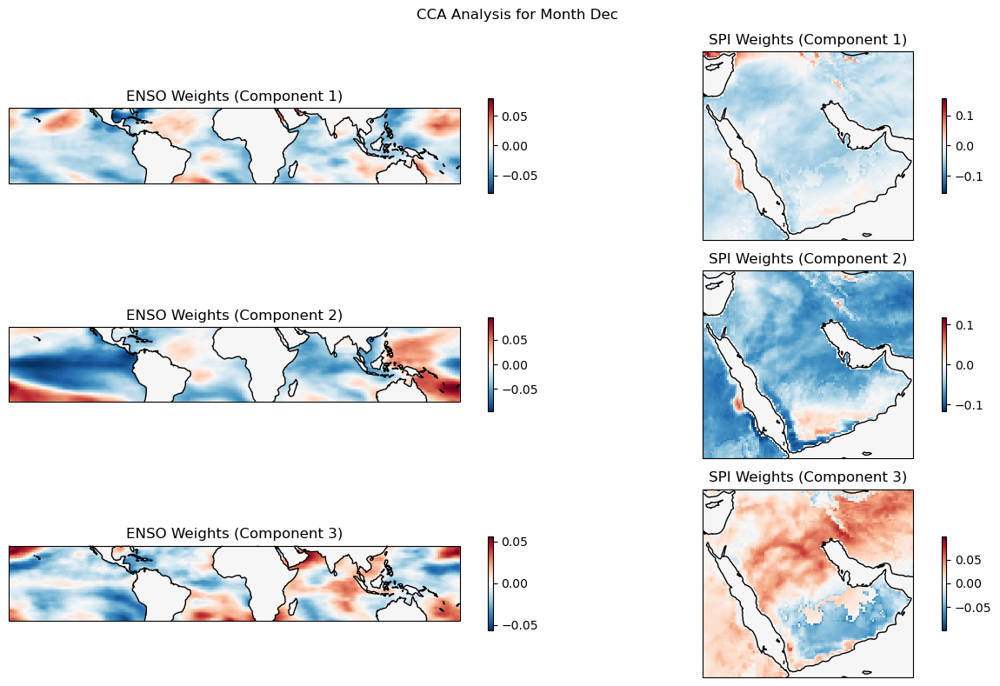

In [125]:
cca_analysis(spi, sst, 3, month='Dec')

## Denoised CCA

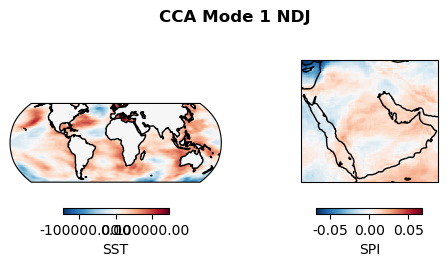

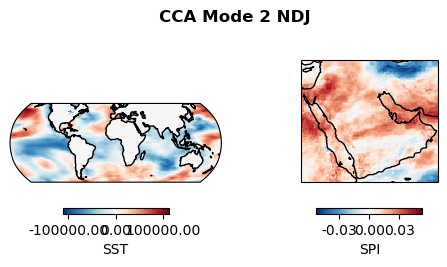

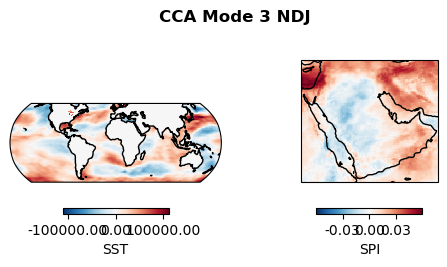

In [113]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=0.9, n_pcs_spi=0.9, month='NDJ')

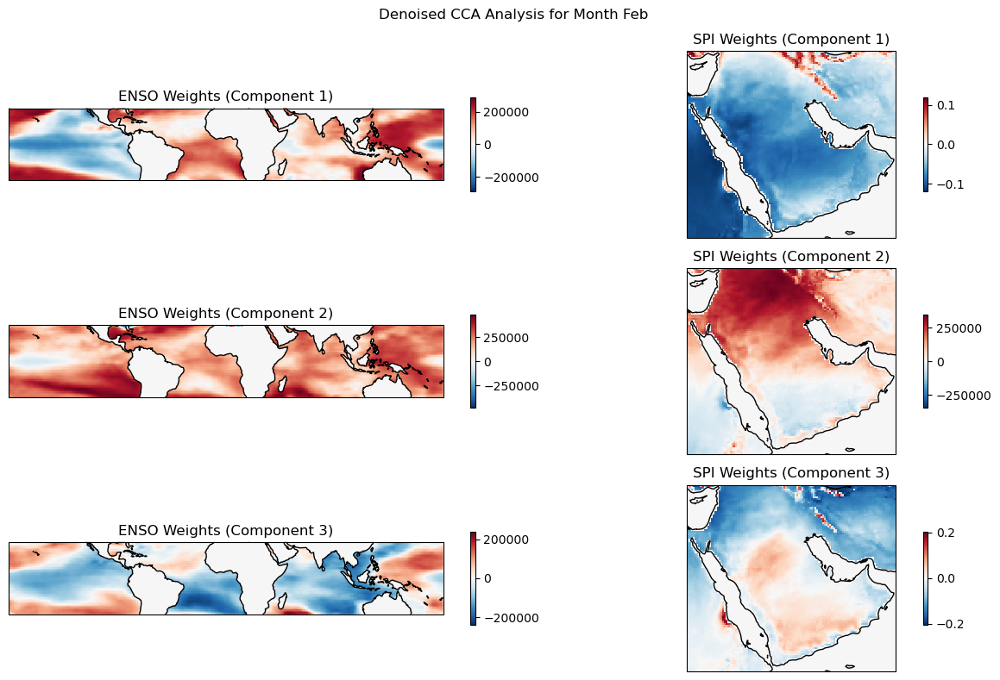

In [127]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Feb')

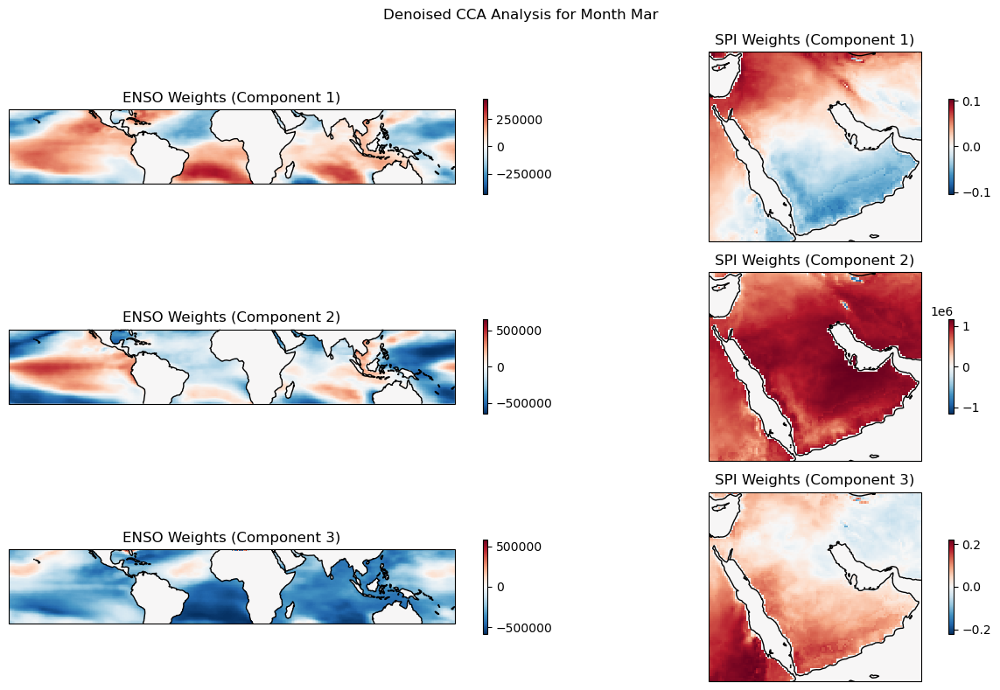

In [128]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Mar')

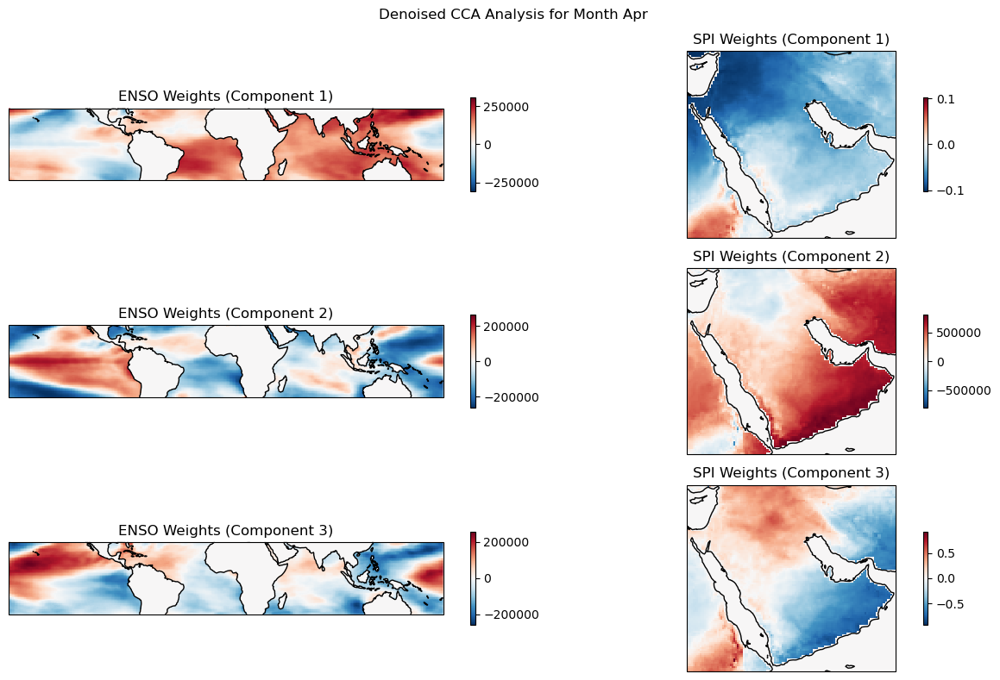

In [129]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Apr')

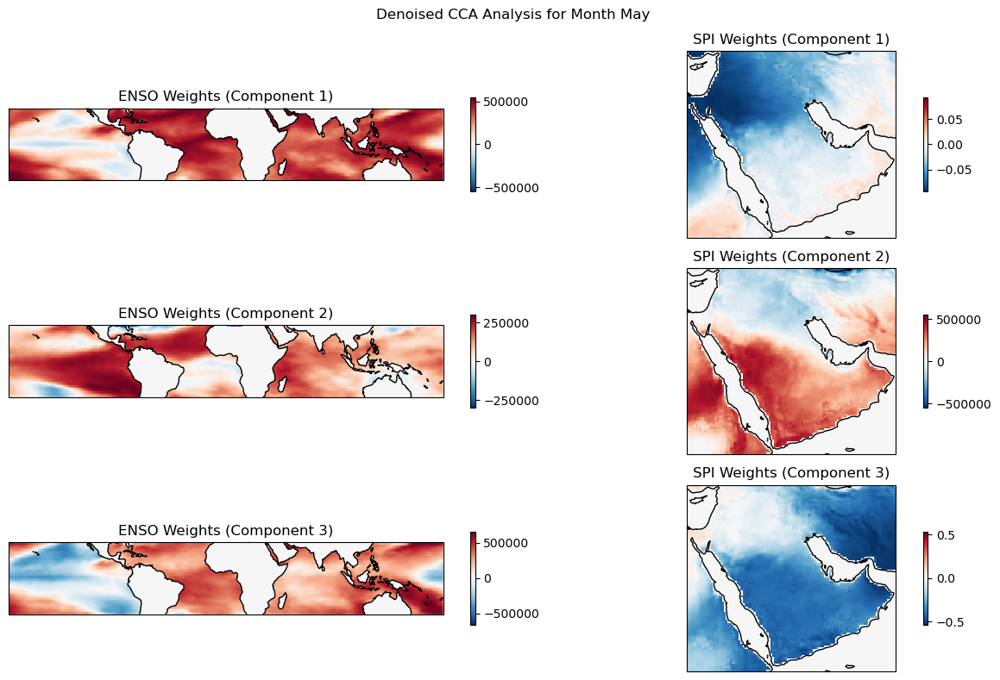

In [130]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='May')

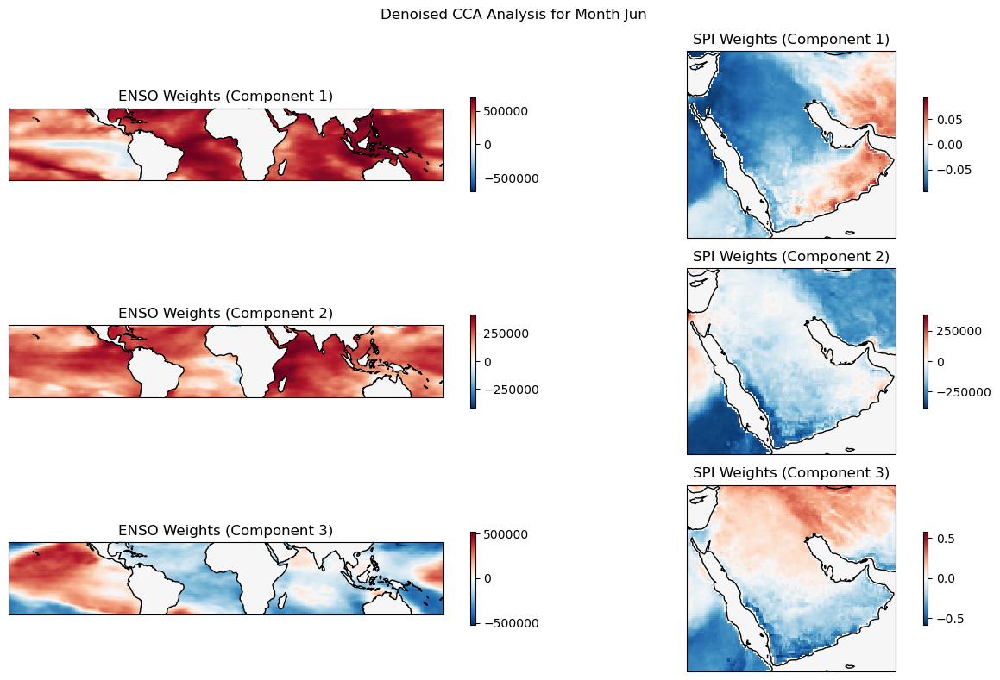

In [131]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Jun')

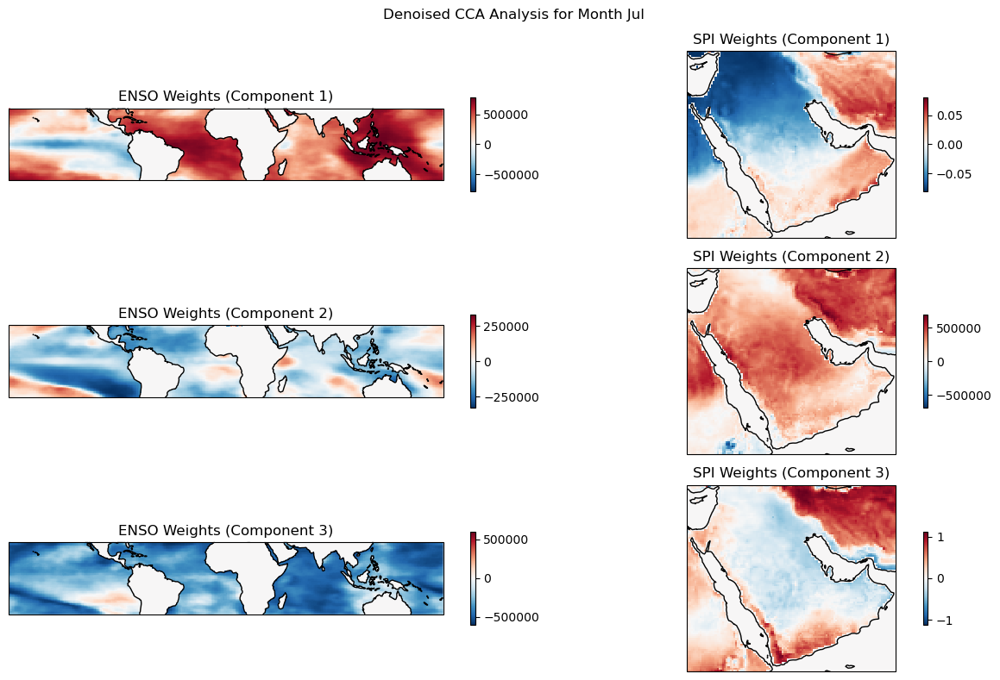

In [132]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Jul')

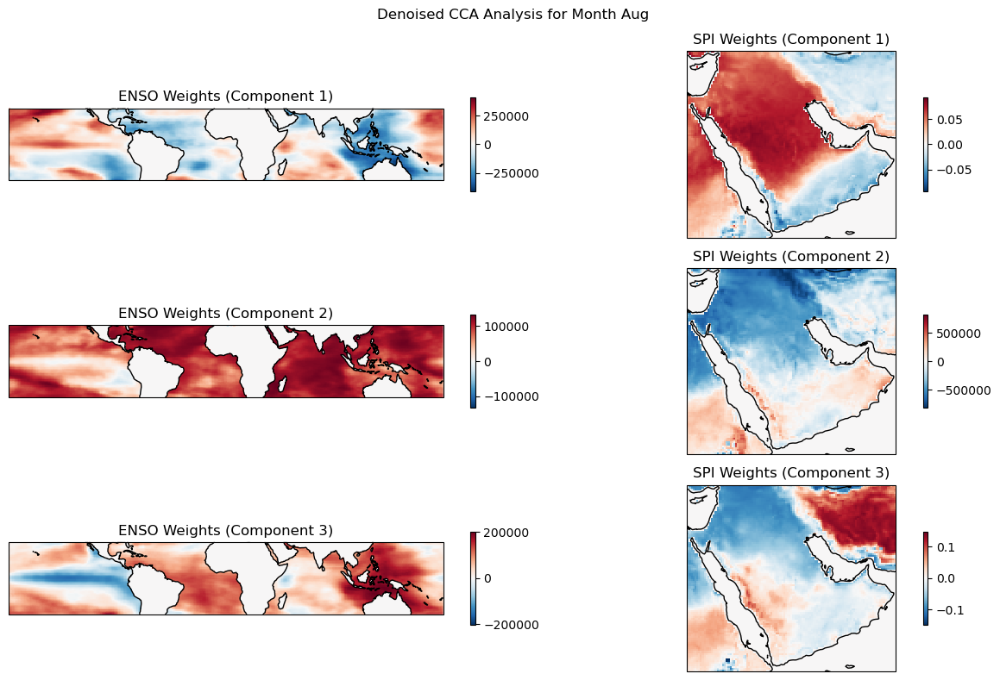

In [133]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Aug')

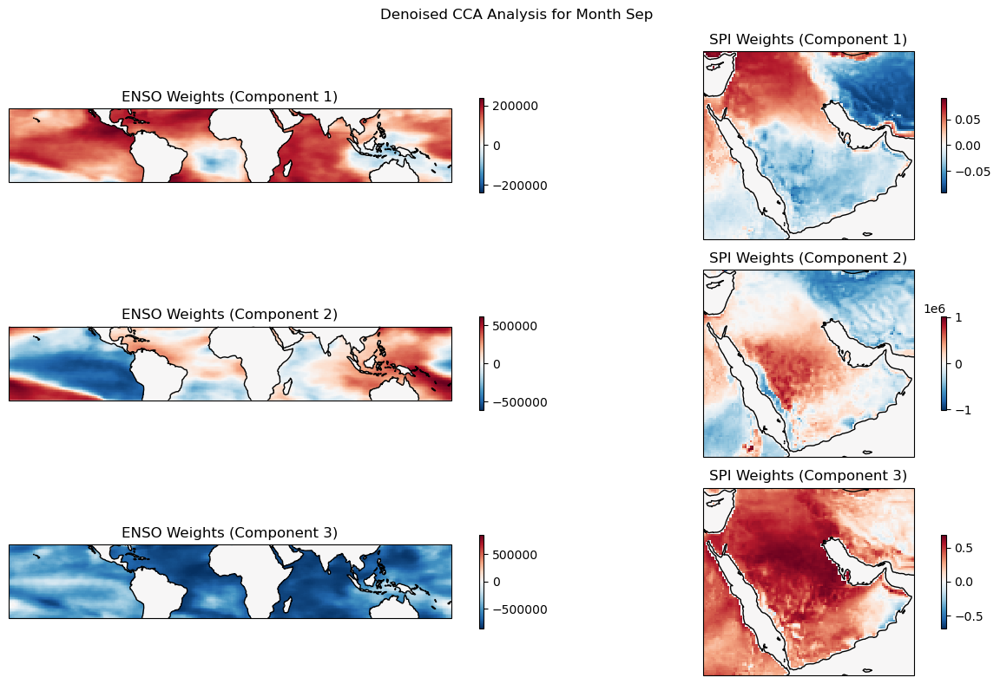

In [134]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Sep')

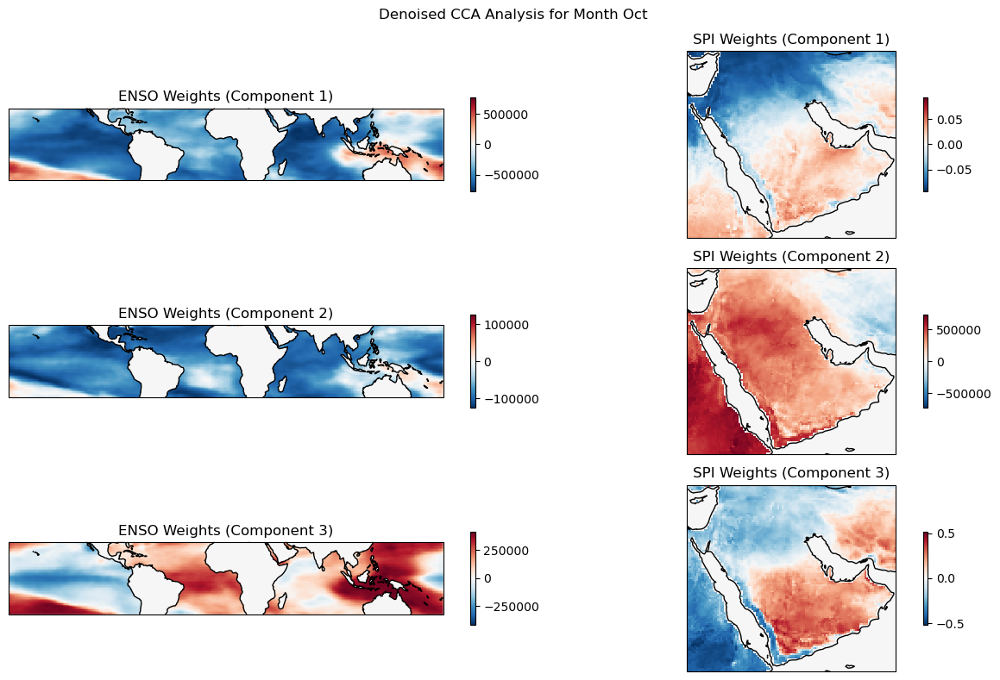

In [135]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Oct')

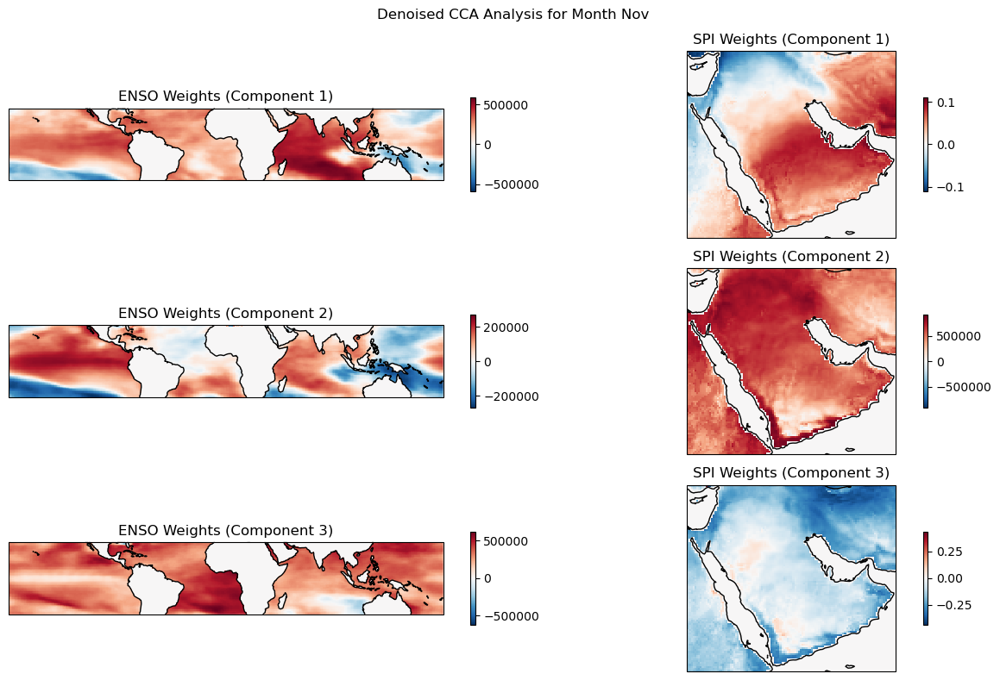

In [136]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Nov')

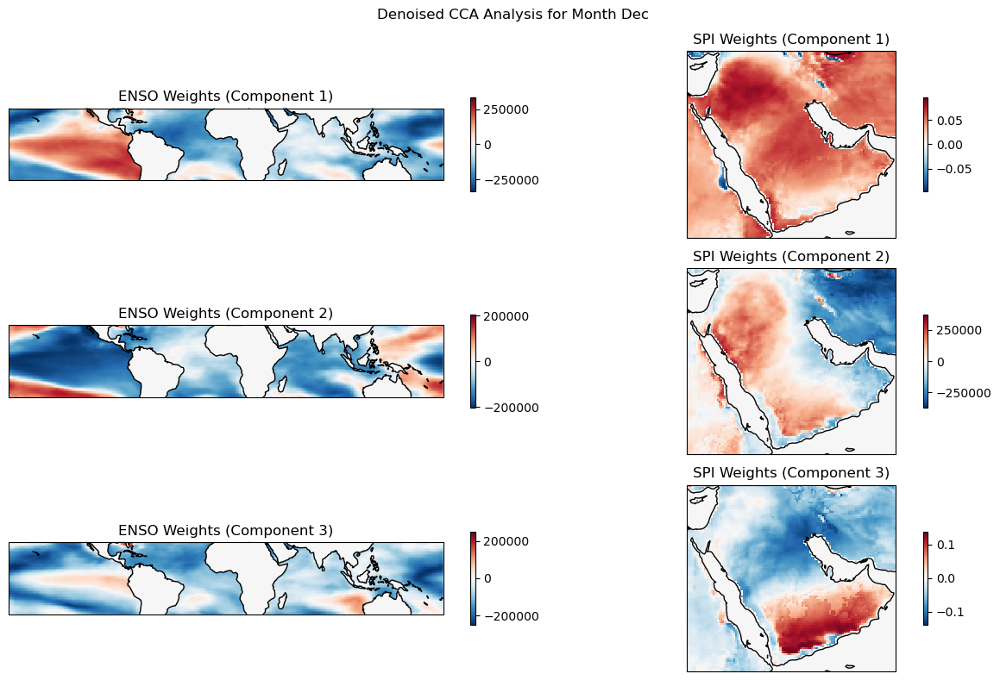

In [137]:
denoised_cca_analysis(spi, sst, n_components_cca=3,n_pcs_sst=5, n_pcs_spi=5, month='Dec')

# Reproduce pycpt

In [4]:
import pycpt
import packaging
min_version = '2.5.0'
assert packaging.version.parse(pycpt.__version__) >= packaging.version.parse(min_version), f'This notebook requires version {min_version} or higher of the pycpt library, but you have version {pycpt.__version__}. Please close the notebook, update your environment, and load the notebook again. See https://iri-pycpt.github.io/installation/'

import cptdl as dl 
from cptextras import get_colors_bars
import datetime as dt
import numpy as np
from pathlib import Path
import xarray as xr
import cptcore as cc

In [163]:
x, y = cc.load_southasia_nmme()
x = x.isel(T=slice(None,-1))
hindcasts, forecasts, skills, patterns_x, patterns_y = cc.canonical_correlation_analysis(x, y,cpt_kwargs={'interactive':True},x_eof_modes=(4,5), y_eof_modes=(4,5))

  
  
             C L I M A T E   P R E D I C T A B I L I T Y   T O O L
                                 Version 17.08
  
                   Evaluating seasonal climate predictability
                         Designed for MOS applications
  
  
  Copyright 2002-2023 International Research Institute for Climate and Society
  
  
 III RRRR  III                                                                 
  I  R   R  I                                                                  
  I  R   R  I                                                                  
  I  RRRR   I                                                                  
  I  R   R  I   I N T E R N A T I O N A L   R E S E A R C H   I N S T I T U T E
 III R   R III  F O R         C L I M A T E         A N D         S O C I E T Y
  
  
 FILE
       141.  New
       142.  Open
       144.  Save As
       145.  Save as Parameter File (turn on)
       131.  Output-file format
       132.  Output-data precision
       1

In [164]:
#impleement class MCA that computes SVD of cross covariance matri xof inputs X, Y

class MCA:
    def __init__(self, X, Y):
        self.X = X
        self.Y = Y
        self.n_components = min(X.shape[1], Y.shape[1])
        self.solve()
        
    def fit(self):
        self.U, self.S, self.V = np.linalg.svd(self.X.T @ self.Y)
        self.U = self.U[:, :self.n_components]
        self.V = self.V[:self.n_components, :]
        self.S = self.S[:self.n_components]
        self.x_cca = self.X @ self.U
        self.y_cca = self.Y @ self.V
        self.x_weights = self.U
        self.y_weights = self.V
        self.skills = self.S**2 / np.sum(self.S**2)
        
#implement class CCA to perform canonical correlation analysis

class MyCCA:
    def __init__(self):
        self.X_weights_ = None
        self.Y_weights_ = None
        self.X_proj_ = None
        self.Y_proj_ = None
        self.covariance_explained_ = None

    def fit(self, X, Y):
        # Center the variables (mean subtraction)
        X = X - X.mean(axis=0)
        Y = Y - Y.mean(axis=0)

        U1,s1,V1t = np.linalg.svd(X,full_matrices=False)
        V1 = V1t.T
        U2,s2,V2t = np.linalg.svd(Y,full_matrices=False)
        V2 = V2t.T

        U1tU2 = U1.T.dot(U2)
        U3,s3,V3t = np.linalg.svd(U1tU2)
        V3 = V3t.T
        
        self.X_weights_ = V1 @ np.linalg.inv(np.diag(s1)) @ U3
        self.Y_weights_ = V2 @ np.linalg.inv(np.diag(s2)) @ V3


        # Project the data onto the canonical variables
        self.X_proj_ = np.dot(X, self.X_weights_)
        self.Y_proj_ = np.dot(Y, self.Y_weights_)

        # Compute the covariance explained by the canonical correlations
        self.covariance_explained_ = s3 / s3.sum()

        return self

pycpt datasets sst and precip or era5 sst + precip

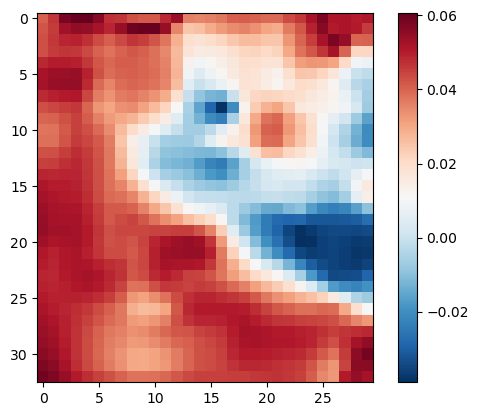

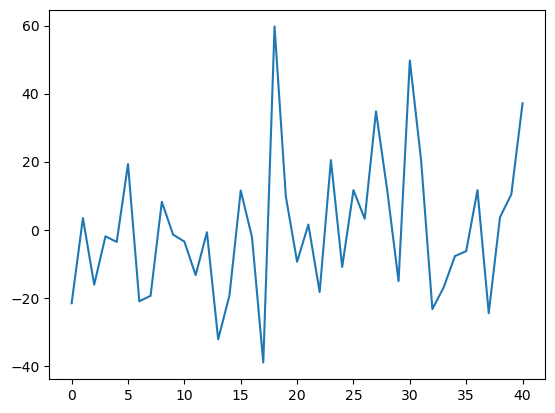

In [168]:
x_2d = x.values.reshape(x.shape[0], -1)
y_2d = y.values.reshape(y.shape[0], -1)

#remove last year from y
y_2d = y_2d[1:]

x_2d_bar = x_2d #  - x_2d.mean(axis=0)
y_2d_bar = y_2d # - y_2d.mean(axis=0)

pca_x = PCA(n_components=4).fit(x_2d_bar)
pca_y = PCA(n_components=4).fit(y_2d_bar)

x_pcs = pca_x.transform(x_2d_bar)
y_pcs = pca_y.transform(y_2d_bar)

#inverse transform
x_denoised = pca_x.inverse_transform(x_pcs)  + x_2d.mean(axis=0)
y_denoised = pca_y.inverse_transform(y_pcs)   + y_2d.mean(axis=0)

x_denoised = (x_denoised) # - x_denoised.mean(axis=0))  / (x_denoised.std(axis=0) + 1e-6)
y_denoised = (y_denoised ) #- y_denoised.mean(axis=0))  / (y_denoised.std(axis=0) + 1e-6)

cca = CCA(n_components=5)

x_cca, y_cca = cca.fit_transform(x_denoised, y_denoised)
x_loadings = cca.x_loadings_
y_loadings = cca.y_loadings_

#plot
plt.imshow(y_loadings[:,0].reshape(x.shape[1], x.shape[2]), cmap='RdBu_r')
plt.colorbar()
plt.show()
plt.plot(x_cca[:,0])

In [176]:
mycca = MCA(x_denoised, y_denoised)

plt.plot(mycca.X_proj_[:,0])

AttributeError: 'MCA' object has no attribute 'X_proj_'

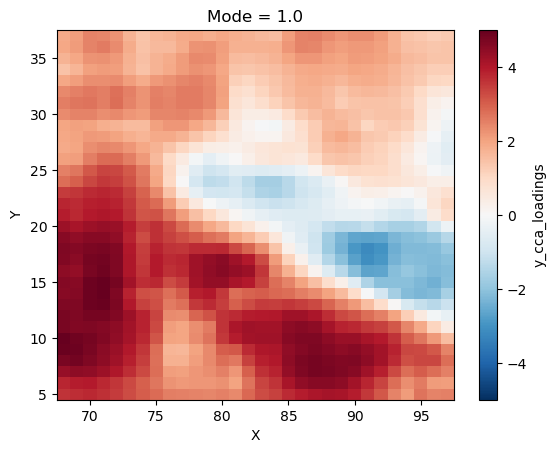

In [166]:
patterns_y.y_cca_loadings.sel(Mode=1).plot()

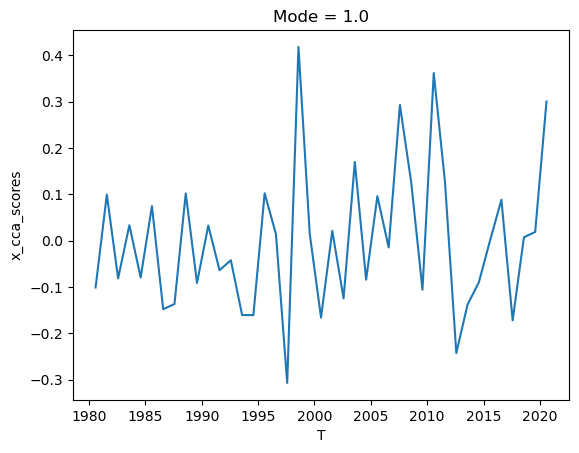

In [167]:
patterns_x.x_cca_scores.sel(Mode=1).plot()

In [169]:
np.corrcoef(patterns_y.y_cca_scores.sel(Mode=1).values, patterns_x.x_cca_scores.sel(Mode=1).values)


array([[1.        , 0.67351284],
       [0.67351284, 1.        ]])

In [170]:
np.corrcoef(x_cca[:,0], y_cca[:,0])

array([[1.        , 0.67272567],
       [0.67272567, 1.        ]])

In [171]:
np.corrcoef(x_cca[:,0], patterns_y.y_cca_scores.sel(Mode=1).values)

array([[1.        , 0.65221673],
       [0.65221673, 1.        ]])